In [1]:
import tensorflow as tf
import numpy as np
import skimage.io
import sklearn.decomposition
import matplotlib.pyplot as plt
from pathlib import Path
import tqdm
from massimal import hyspec_io, hyspec_ml, preprocess, image_render, annotation
import datetime
import matplotlib.pyplot as plt
import matplotlib

In [2]:
# Paths
hyspec_base = Path('/home/mha114/data/massimal/vega_sola/hyperspec/images/2a_rrs/')
train_annotation_dir = Path('/home/mha114/data/massimal/vega_sola/hyperspec/annotation/v2.1/png_gray/train_test_split_v2/train/')
val_annotation_dir = Path('/home/mha114/data/massimal/vega_sola/hyperspec/annotation/v2.1/png_gray/train_test_split_v2/val/')

annotation_json = Path('/home/mha114/data/massimal/vega_sola/hyperspec/annotation/v2.1/png_gray/label_classes.json')
water_mask_dir = Path('/home/mha114/data/massimal/vega_sola/hyperspec/watermask/')
pca_model_path = Path('/home/mha114/data/massimal/vega_sola/hyperspec/pca_models/vega_sola_pca_model_original_class_dist_2024-04-28-16h26m34s.npz')

train_pca_im_dir = Path('/home/mha114/data/massimal/vega_sola/hyperspec/datasets/pca_images/pca_images_log_rrs_v2/train/')
val_pca_im_dir = Path('/home/mha114/data/massimal/vega_sola/hyperspec/datasets/pca_images/pca_images_log_rrs_v2/val/')
train_pca_im_dir.mkdir(parents=True,exist_ok=True)
val_pca_im_dir.mkdir(parents=True,exist_ok=True)


In [3]:
# Parameters
wl_min = 400
wl_max = 730
minimum_reflectance = 0.001

grouped_class_indices = {
    'Sand': {9}, 
    'Bedrock': {4}, 
    'Maerl': {33}, 
    'Rockweed': {19, 20, 21, 22, 23, 25, 26, 27}, 
    'Kelp': {13, 14, 15}, 
    'Chorda filum': {29}, 
    'Brown algae (deep)': {12, 16, 17, 18, 24, 30}}

custom_cmap = matplotlib.colors.ListedColormap(colors=['darkgray',           # Background - darkgray 
                                                       'darkturquoise',   # Sand
                                                       'pink',            # Bedrock
                                                       'magenta',         # Maerl bed
                                                       'seagreen',        # Rockweed
                                                       'darkorange',      # Kelp 
                                                       'red',             # Chorda filum (alt. 'lime'?)
                                                       'brown'])          # Brown algae

In [4]:
train_label_image_paths = [path for path in sorted(train_annotation_dir.rglob('*.bip.png'))]
print(f'{len(train_label_image_paths)} training images')
val_label_image_paths = [path for path in sorted(val_annotation_dir.rglob('*.bip.png'))]
print(f'{len(val_label_image_paths)} validation images')


75 training images
39 validation images


In [5]:
# Load PCA model, limit to 5 components
W_pca,X_mean,_,wl = hyspec_ml.read_pca_model(pca_model_path,include_feature_labels=True)
W_pca = W_pca[0:5]

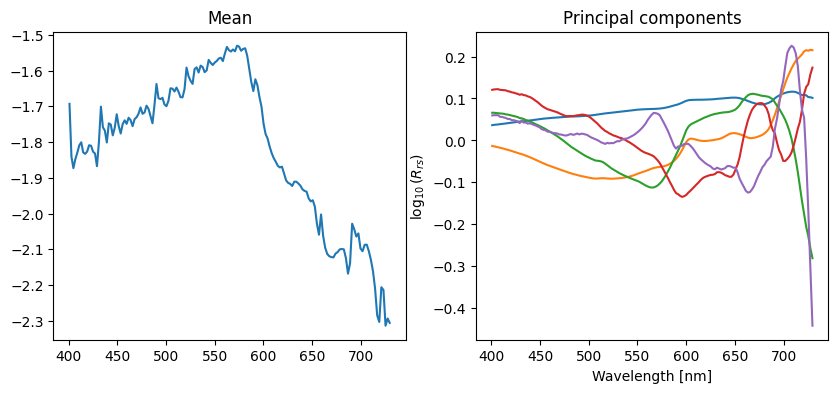

In [10]:
# Plot mean and all components
fig, ax = plt.subplots(ncols=2,figsize=(10,4))
ax[0].plot(wl,X_mean)
ax[0].set_title('Mean')
ax[1].set_xlabel('Wavelength [nm]')
ax[1].plot(wl,W_pca.T)
ax[1].set_xlabel('Wavelength [nm]')
ax[1].set_ylabel('$\log_{10}(R_{rs})$')
ax[1].set_title('Principal components')
plt.show()

In [11]:
# Loop over images, PCA transform, inpaint, save
def create_pca_images(label_image_paths,pca_im_dir,grouped_class_indices):
    for i,label_image_path in enumerate(label_image_paths):
        print(f'Processing image {i+1} of {len(label_image_paths)}: {label_image_path.name}')
        hyspec_image_path = [path for path in hyspec_base.rglob(label_image_path.stem+'*.hdr')][0]
        water_mask_path = [path for path in water_mask_dir.rglob(label_image_path.stem+'*.png')][0]

        # Read images
        label_image = skimage.io.imread(label_image_path)
        water_mask_image = np.expand_dims(skimage.io.imread(water_mask_path),axis=2)

        # Load hyperspectral image, apply water mask
        (hyspec_image,wl,rgb_ind,_) = hyspec_io.load_envi_image(str(hyspec_image_path))
        hyspec_image = hyspec_image*water_mask_image

        # Set labels for zero-valued pixels to background
        label_image[np.all(hyspec_image==0,axis=2)] = 0
        
        # Group labels
        group_label_image, group_indices = annotation.class_map_for_grouped_indices(
            label_image, grouped_class_indices)

        # Limit wavelength range, calculate logarithmic values for reflectance
        wl_ind = (wl>=wl_min) & (wl<=wl_max)
        hyspec_image[hyspec_image<minimum_reflectance] = minimum_reflectance
        hyspec_image = np.log10(hyspec_image[:,:,wl_ind])

        # Create PCA image
        im_pca = hyspec_ml.pca_transform_image(hyspec_image,W_pca,X_mean)

        # Inpaint PCA image
        #im_pca_inpaint = preprocess.inpaint_missing_pixels(im_pca)

        # Plot images    
        fig,ax = plt.subplots(ncols=4,figsize=(10,6))
        ax[0].imshow(group_label_image,interpolation='none',cmap=custom_cmap,vmin=0,vmax=(len(grouped_class_indices)-0.01))
        ax[1].imshow(water_mask_image,interpolation='none',vmin=0,vmax=1)
        ax[2].imshow(image_render.percentile_stretch(hyspec_image[:,:,rgb_ind]))
        ax[3].imshow(image_render.percentile_stretch(im_pca[:,:,(2,1,0)]))
        for current_ax, title in zip(ax,['Labels','Water mask','Hyperspec','PCA']):
            current_ax.set_title(title)
        plt.show()

        # Save as tensorflow dataset
        dataset = tf.data.Dataset.from_tensors((im_pca,group_label_image))  # Use tf.data.Dataset.concatenate to merge later
        dataset_save_path = pca_im_dir / label_image_path.stem
        tf.data.experimental.save(dataset, path=str(dataset_save_path))


Processing image 1 of 75: Vega_SolaNW_Coast1_Pika_L_10-Crop Wavelengths.bip.png


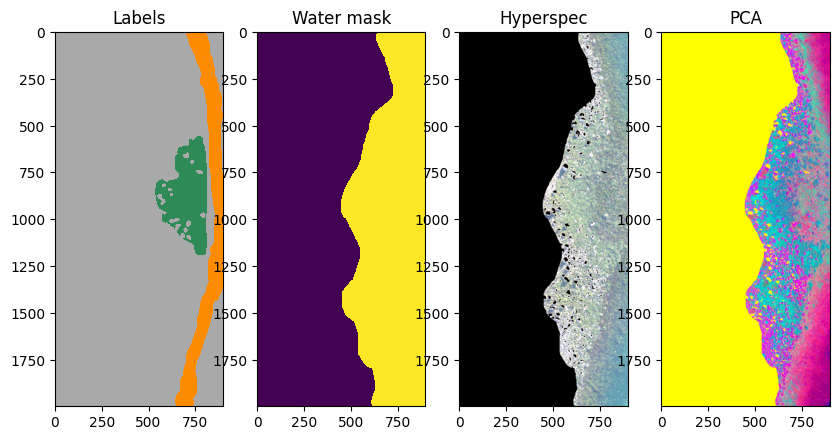

Processing image 2 of 75: Vega_SolaNW_Coast1_Pika_L_11-Crop Wavelengths.bip.png


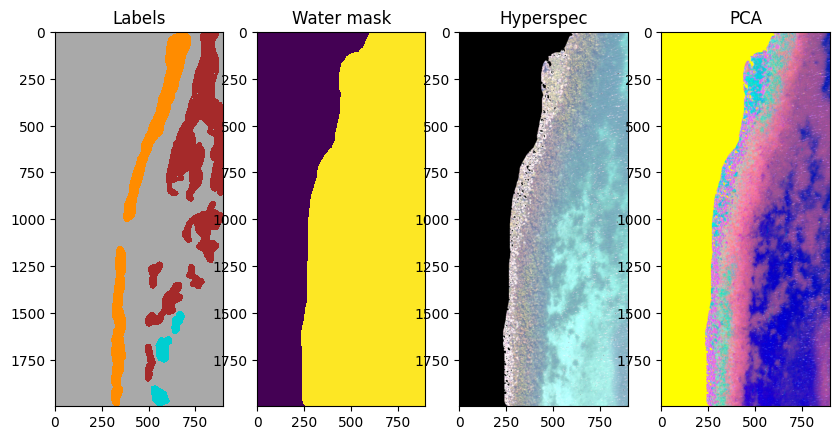

Processing image 3 of 75: Vega_SolaNW_Coast1_Pika_L_12-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


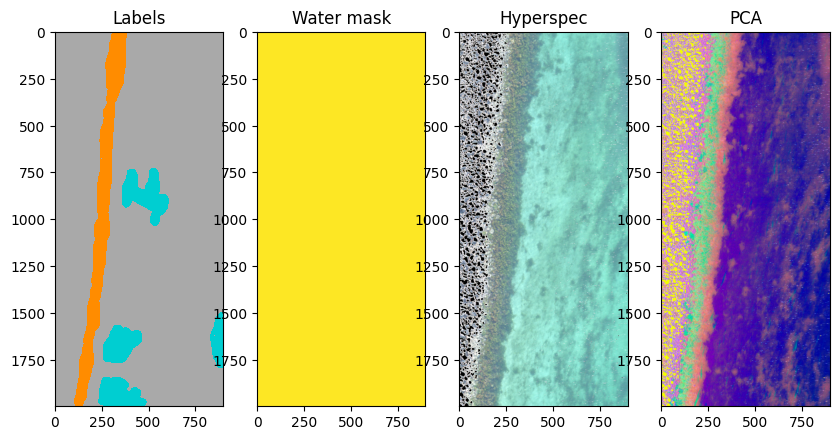

Processing image 4 of 75: Vega_SolaNW_Coast1_Pika_L_13-Crop Wavelengths.bip.png


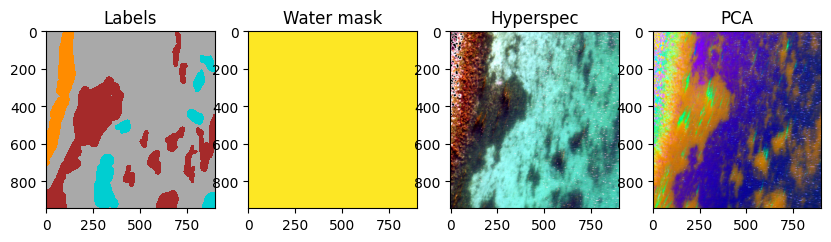

Processing image 5 of 75: Vega_SolaNW_Coast1_Pika_L_15-Crop Wavelengths.bip.png


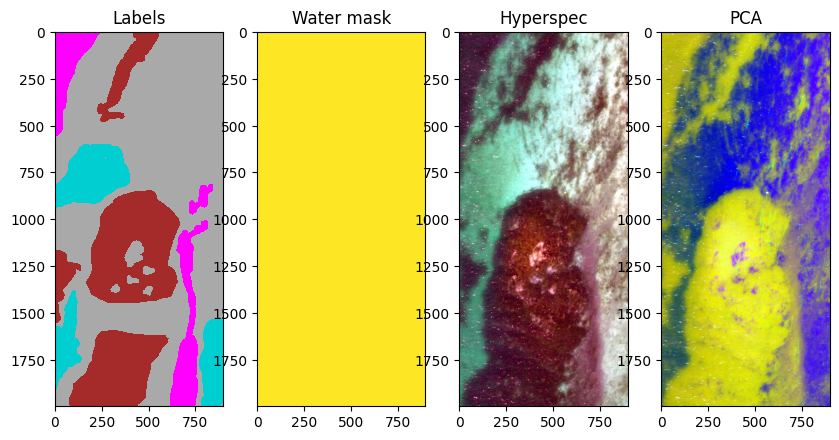

Processing image 6 of 75: Vega_SolaNW_Coast1_Pika_L_16-Crop Wavelengths.bip.png


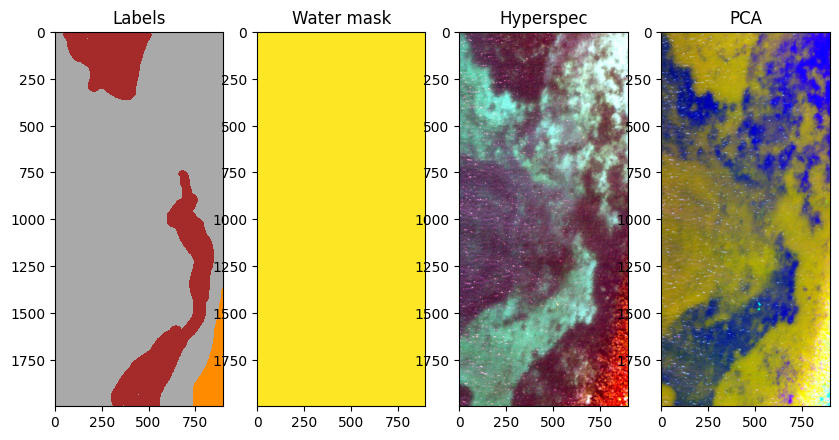

Processing image 7 of 75: Vega_SolaNW_Coast1_Pika_L_17-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


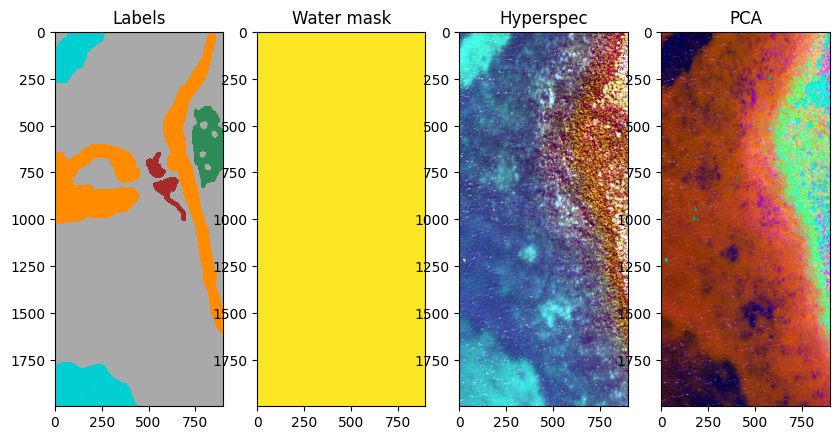

Processing image 8 of 75: Vega_SolaNW_Coast1_Pika_L_18-Crop Wavelengths.bip.png


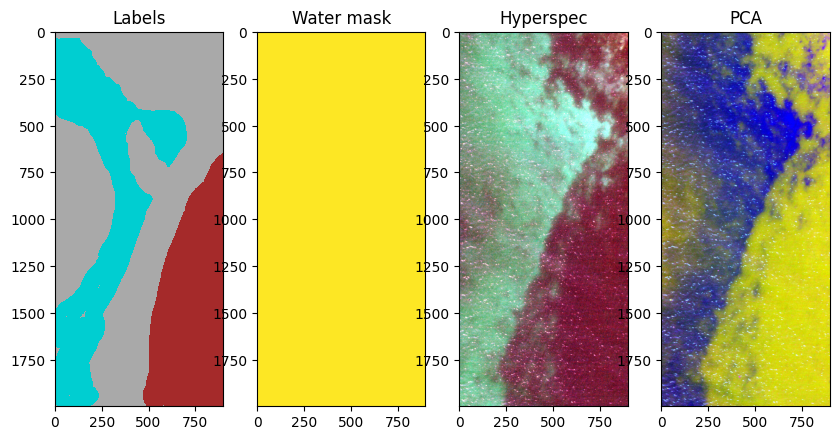

Processing image 9 of 75: Vega_SolaNW_Coast1_Pika_L_22-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


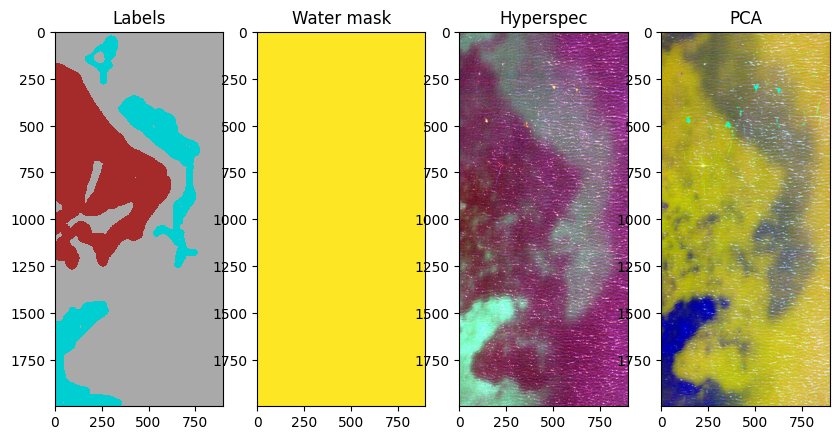

Processing image 10 of 75: Vega_SolaNW_Coast1_Pika_L_23-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


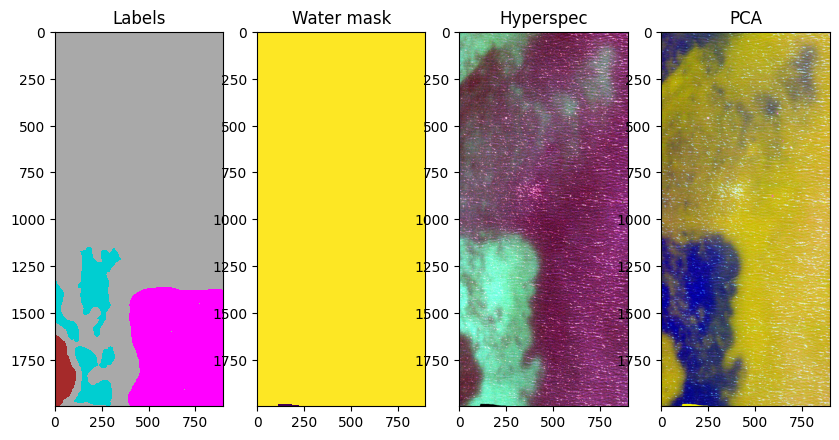

Processing image 11 of 75: Vega_SolaNW_Coast1_Pika_L_24-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


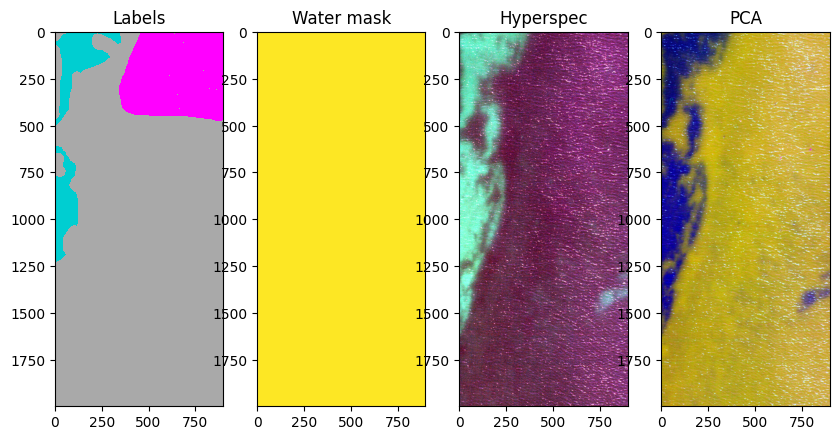

Processing image 12 of 75: Vega_SolaNW_Coast1_Pika_L_6-Crop Wavelengths.bip.png


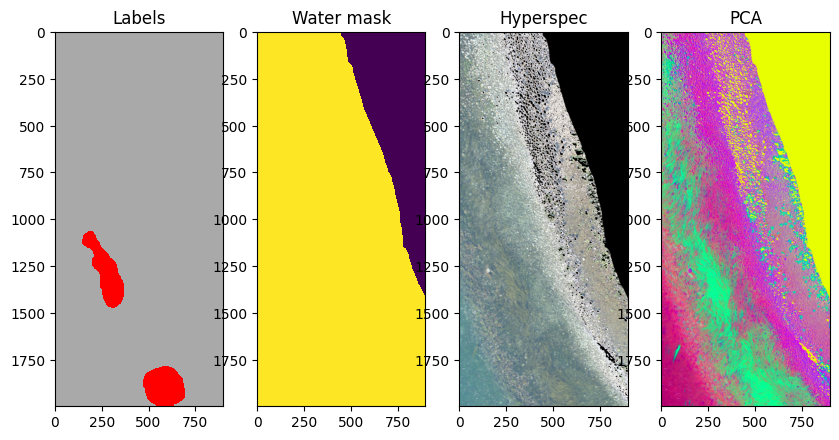

Processing image 13 of 75: Vega_SolaNW_Coast1_Pika_L_7-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


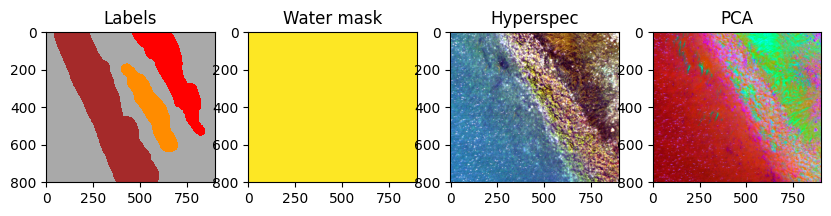

Processing image 14 of 75: Vega_SolaNW_Coast1_Pika_L_8-Crop Wavelengths.bip.png


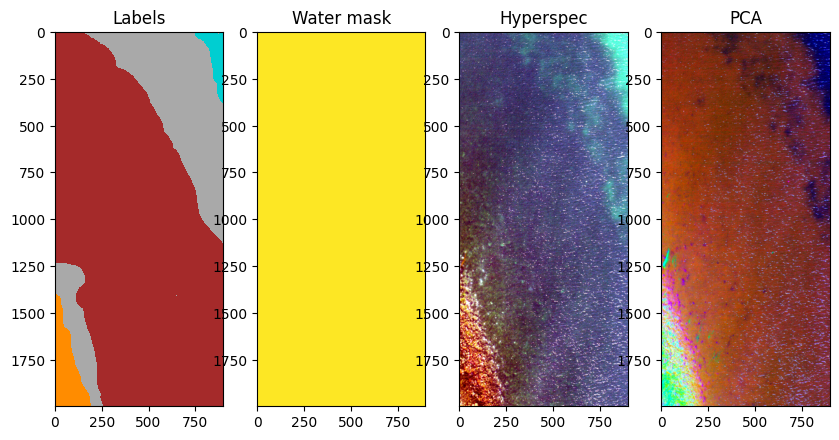

Processing image 15 of 75: Vega_SolaNW_Coast1_Pika_L_9-Crop Wavelengths.bip.png


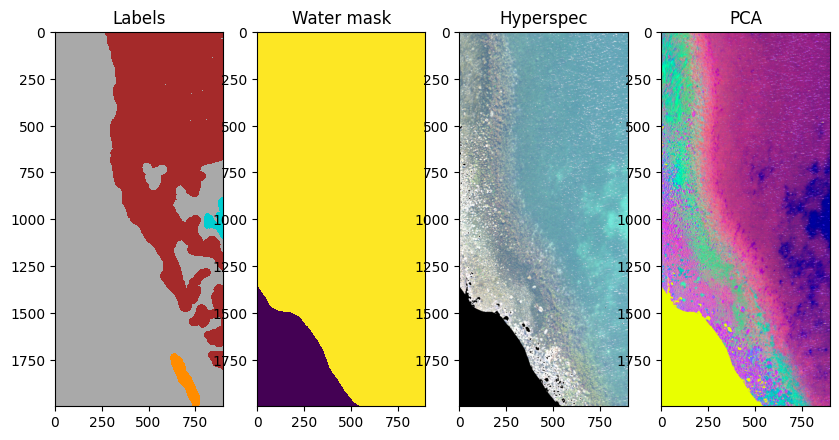

Processing image 16 of 75: Vega_SolaNW_Coast2_Pika_L_15-Crop Wavelengths.bip.png


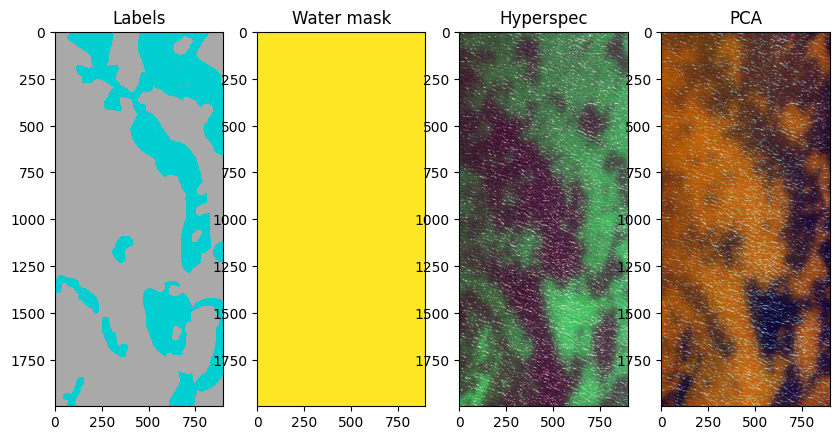

Processing image 17 of 75: Vega_SolaNW_Coast2_Pika_L_16-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


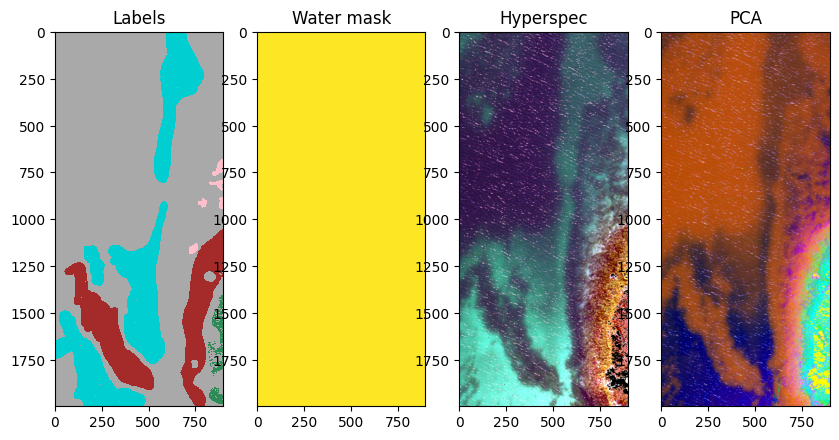

Processing image 18 of 75: Vega_SolaNW_Coast2_Pika_L_17-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


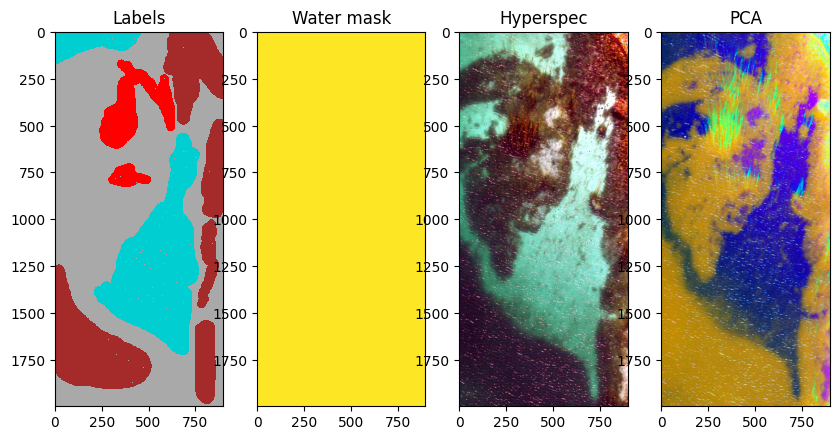

Processing image 19 of 75: Vega_SolaNW_Coast2_Pika_L_19-Crop Wavelengths.bip.png


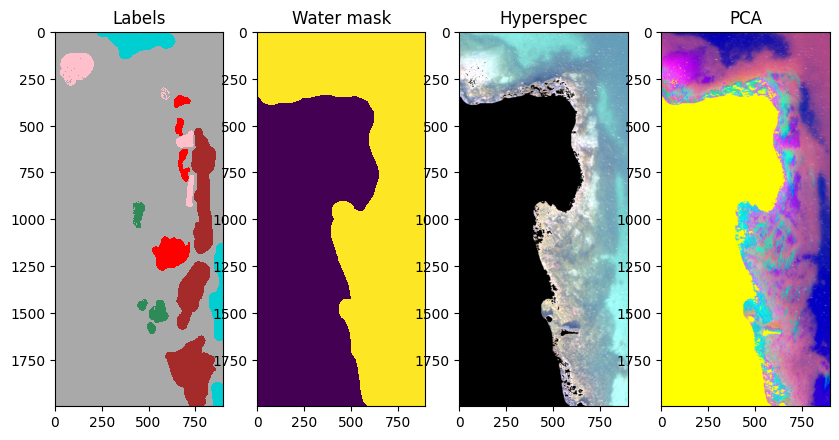

Processing image 20 of 75: Vega_SolaNW_Coast2_Pika_L_20-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


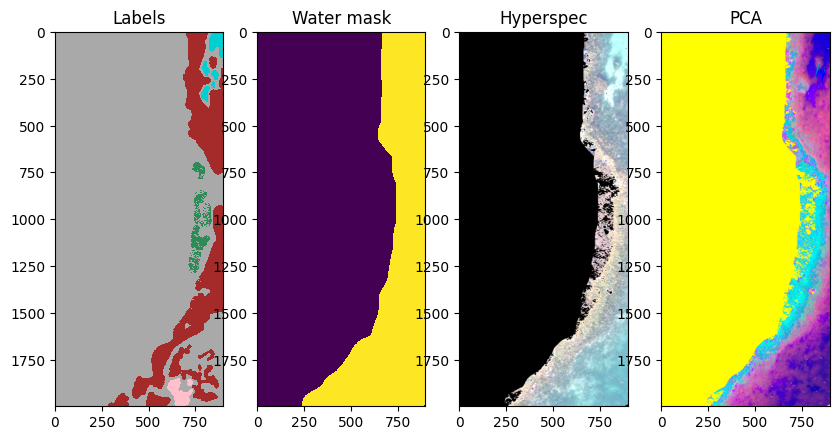

Processing image 21 of 75: Vega_SolaNW_Coast2_Pika_L_21-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


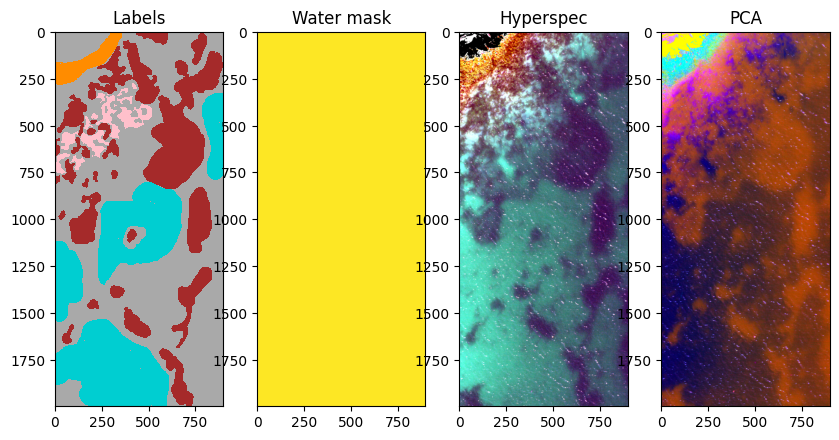

Processing image 22 of 75: Vega_SolaNW_Coast2_Pika_L_26-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


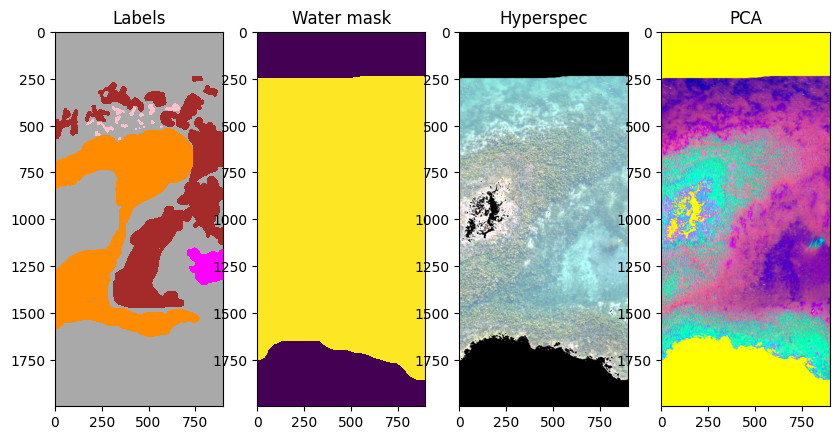

Processing image 23 of 75: Vega_SolaNW_Coast2_Pika_L_28-Crop Wavelengths.bip.png


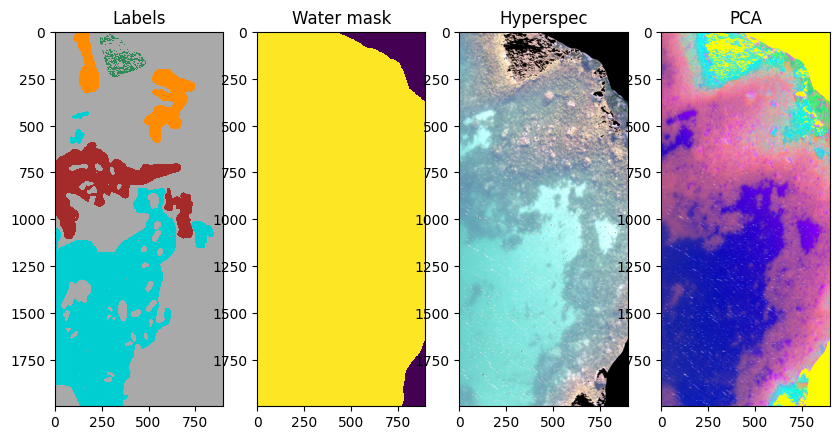

Processing image 24 of 75: Vega_SolaNW_Coast2_Pika_L_5-Crop Wavelengths.bip.png


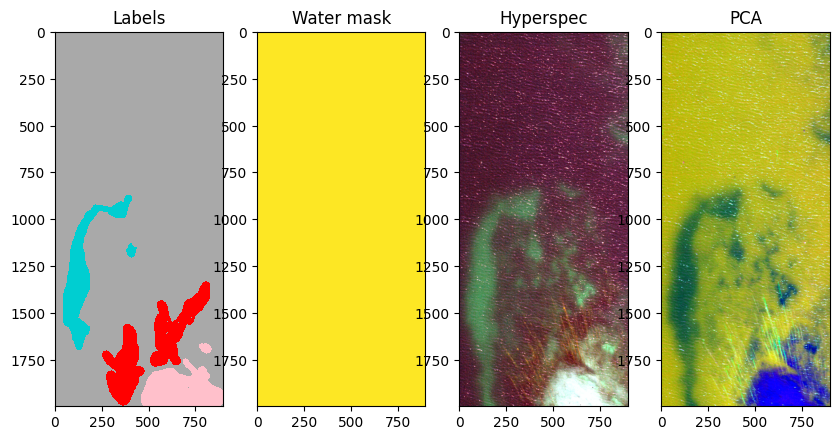

Processing image 25 of 75: Vega_SolaNW_Coast2_Pika_L_6-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


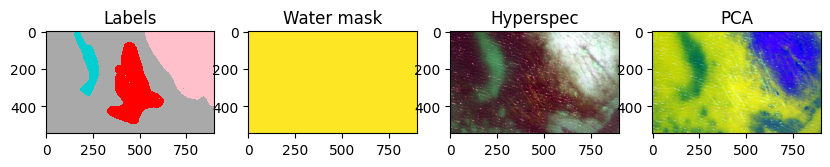

Processing image 26 of 75: Vega_SolaNW_Coast2_Pika_L_7-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


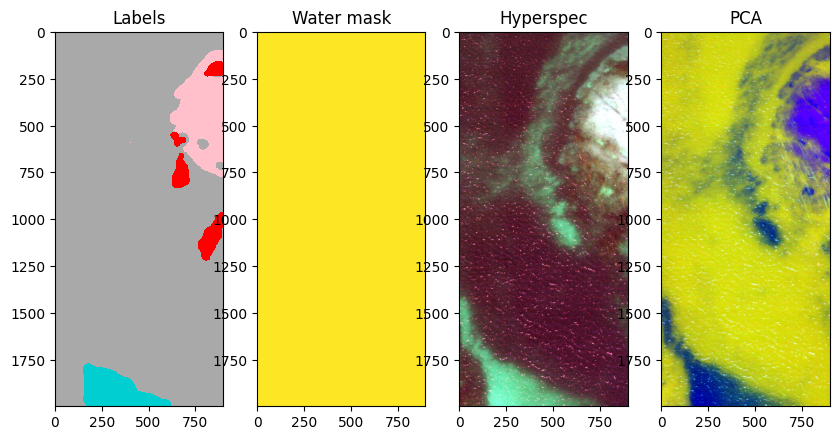

Processing image 27 of 75: Vega_SolaNW_Coast3_Pika_L_10-Crop Wavelengths.bip.png


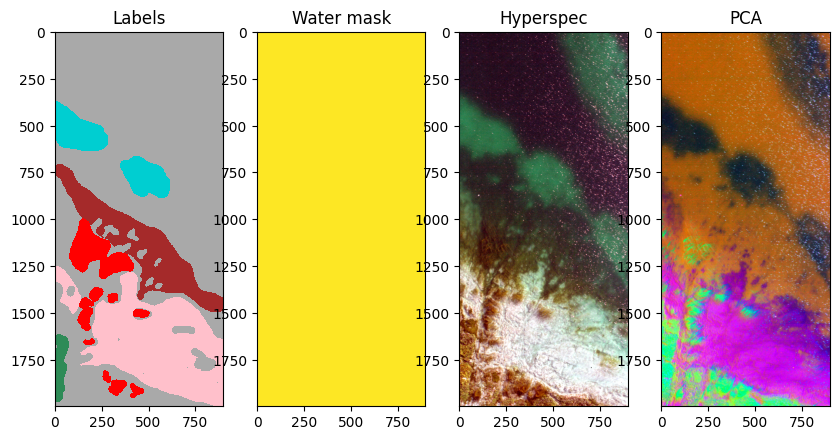

Processing image 28 of 75: Vega_SolaNW_Coast3_Pika_L_11-Crop Wavelengths.bip.png


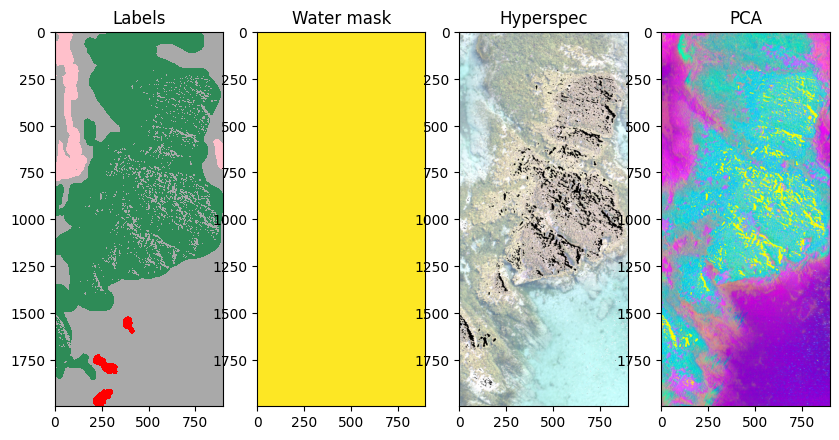

Processing image 29 of 75: Vega_SolaNW_Coast3_Pika_L_12-Crop Wavelengths.bip.png


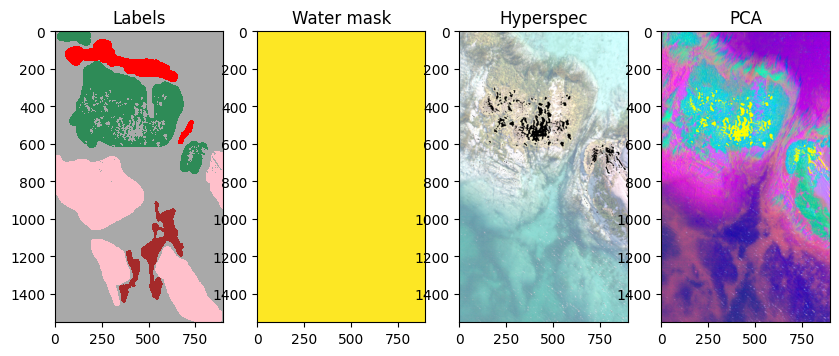

Processing image 30 of 75: Vega_SolaNW_Coast3_Pika_L_13-Crop Wavelengths.bip.png


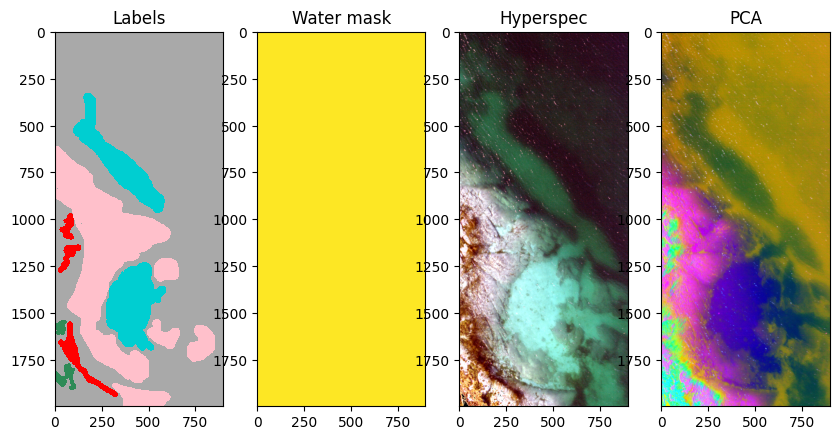

Processing image 31 of 75: Vega_SolaNW_Coast3_Pika_L_14-Crop Wavelengths.bip.png


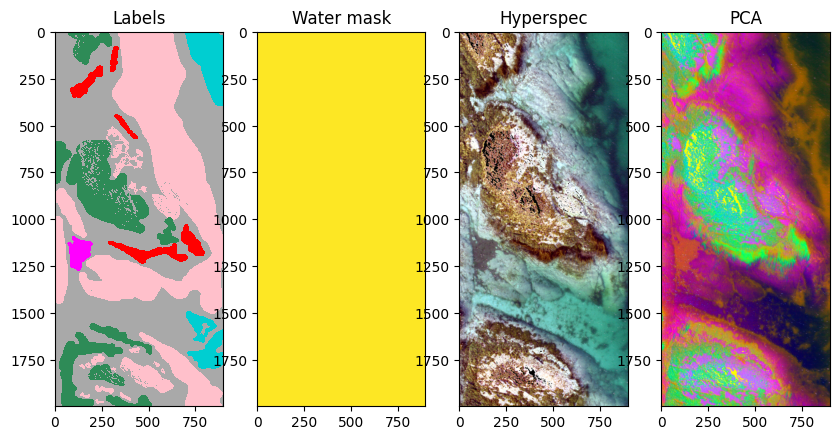

Processing image 32 of 75: Vega_SolaNW_Coast3_Pika_L_15-Crop Wavelengths.bip.png


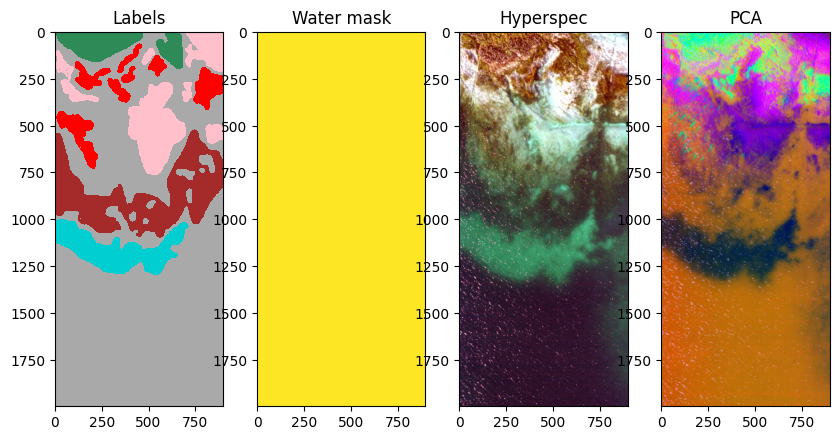

Processing image 33 of 75: Vega_SolaNW_Coast3_Pika_L_18-Crop Wavelengths.bip.png


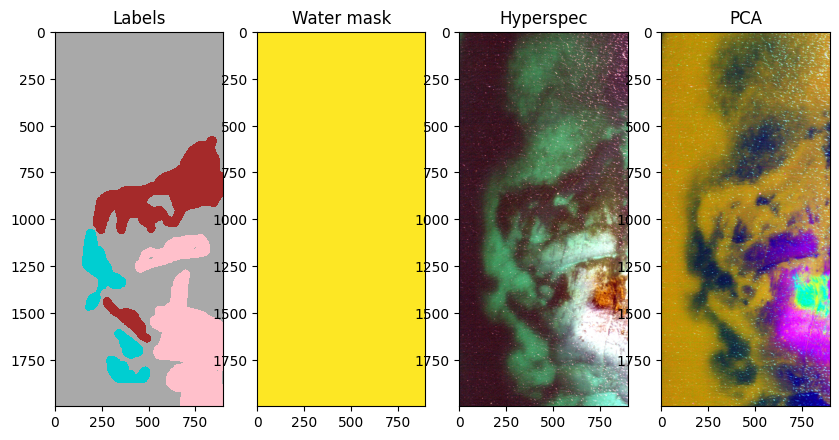

Processing image 34 of 75: Vega_SolaNW_Coast3_Pika_L_19-Crop Wavelengths.bip.png


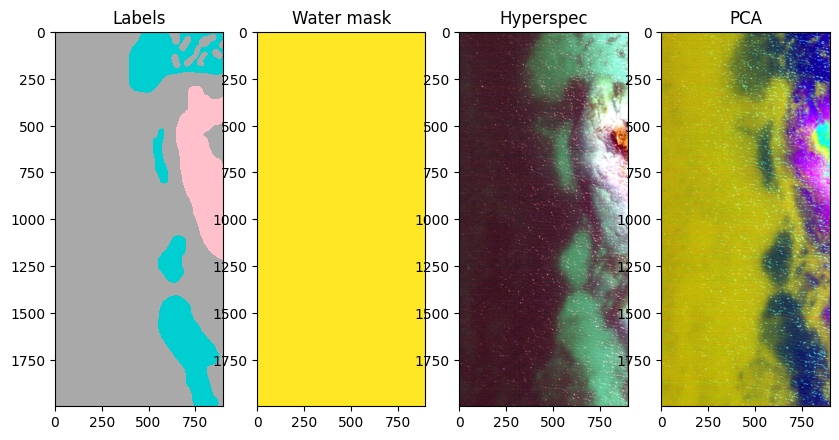

Processing image 35 of 75: Vega_SolaNW_Coast3_Pika_L_2-Crop Wavelengths.bip.png


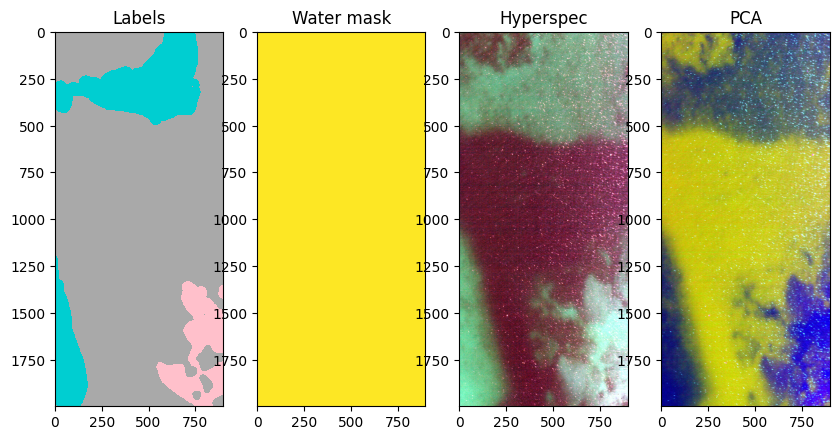

Processing image 36 of 75: Vega_SolaNW_Coast3_Pika_L_21-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


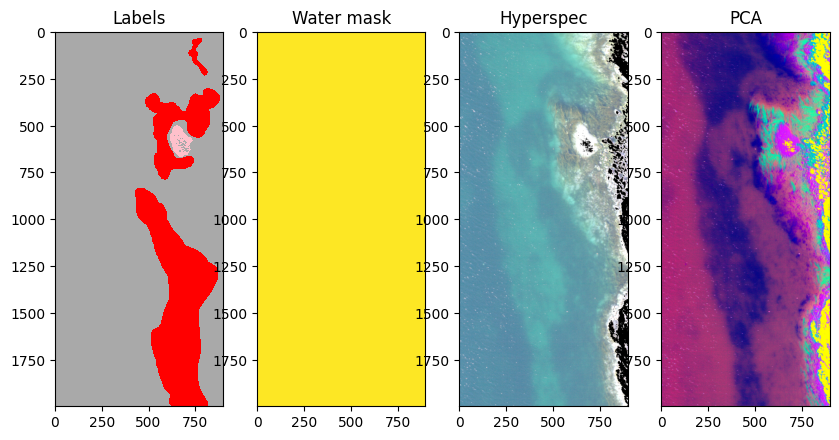

Processing image 37 of 75: Vega_SolaNW_Coast3_Pika_L_22-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


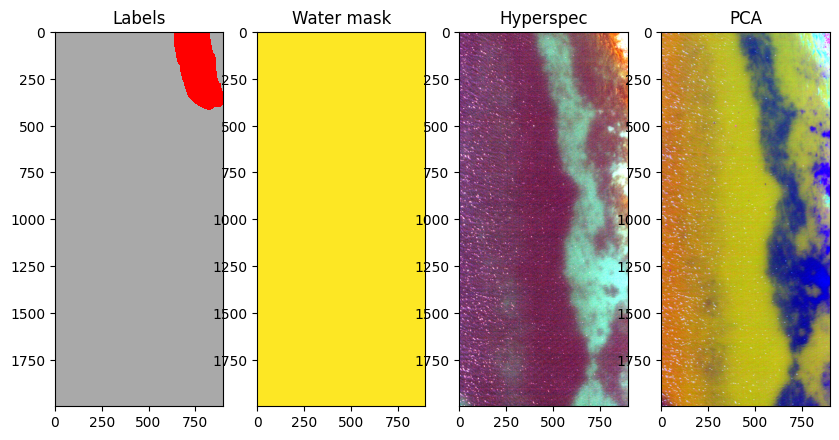

Processing image 38 of 75: Vega_SolaNW_Coast3_Pika_L_23-Crop Wavelengths.bip.png


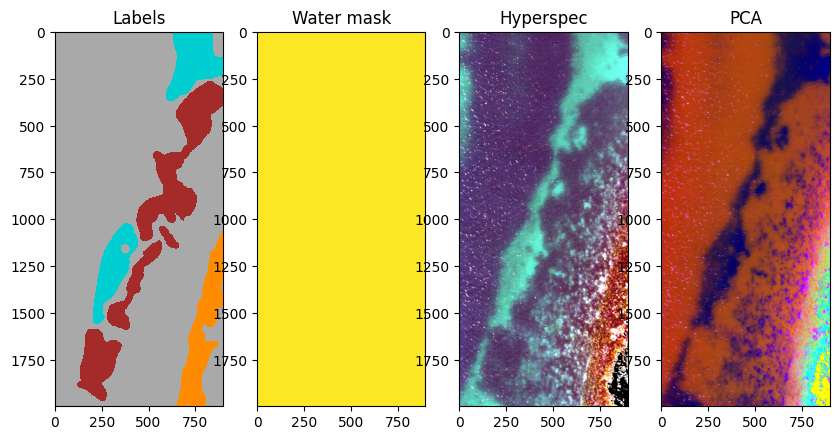

Processing image 39 of 75: Vega_SolaNW_Coast3_Pika_L_24-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


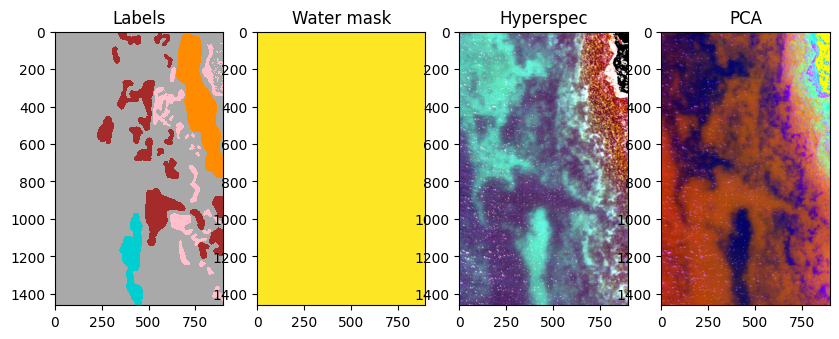

Processing image 40 of 75: Vega_SolaNW_Coast3_Pika_L_25-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


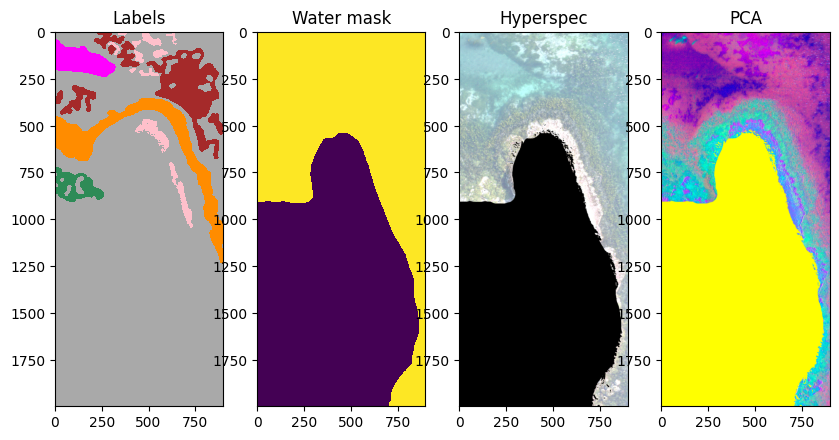

Processing image 41 of 75: Vega_SolaNW_Coast3_Pika_L_26-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


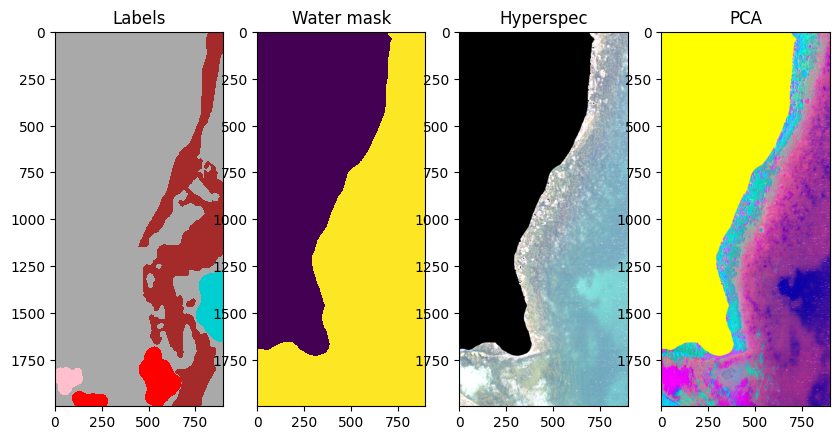

Processing image 42 of 75: Vega_SolaNW_Coast3_Pika_L_27-Crop Wavelengths.bip.png


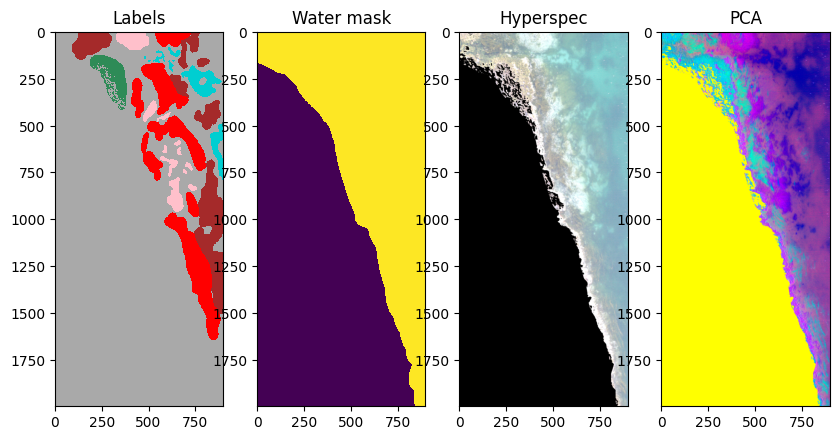

Processing image 43 of 75: Vega_SolaNW_Coast3_Pika_L_3-Crop Wavelengths.bip.png


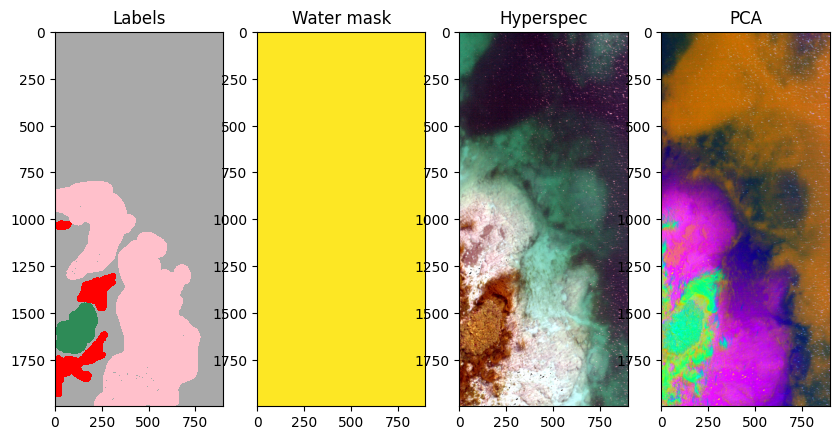

Processing image 44 of 75: Vega_SolaNW_Coast3_Pika_L_4-Crop Wavelengths.bip.png


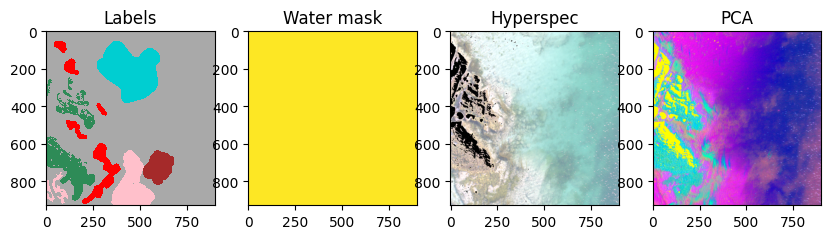

Processing image 45 of 75: Vega_SolaNW_Coast3_Pika_L_5-Crop Wavelengths.bip.png


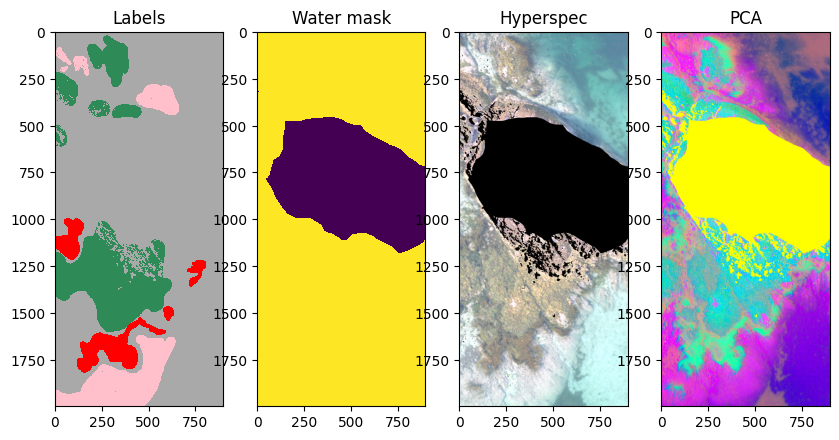

Processing image 46 of 75: Vega_SolaNW_Coast3_Pika_L_6-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


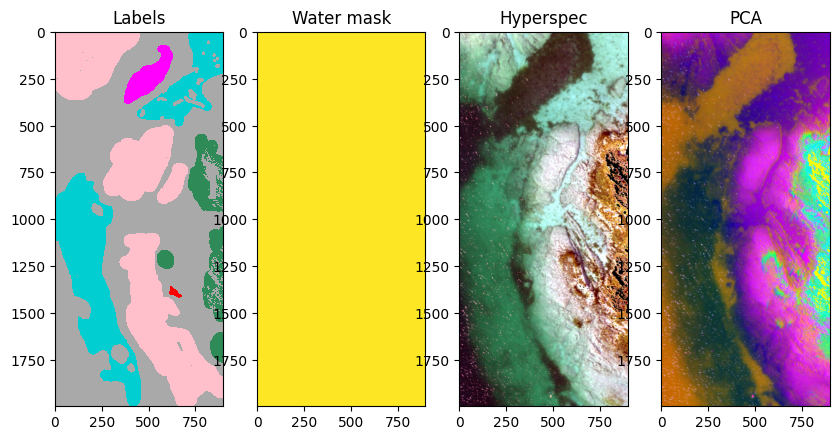

Processing image 47 of 75: Vega_SolaNW_Sound1_Pika_L_1-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


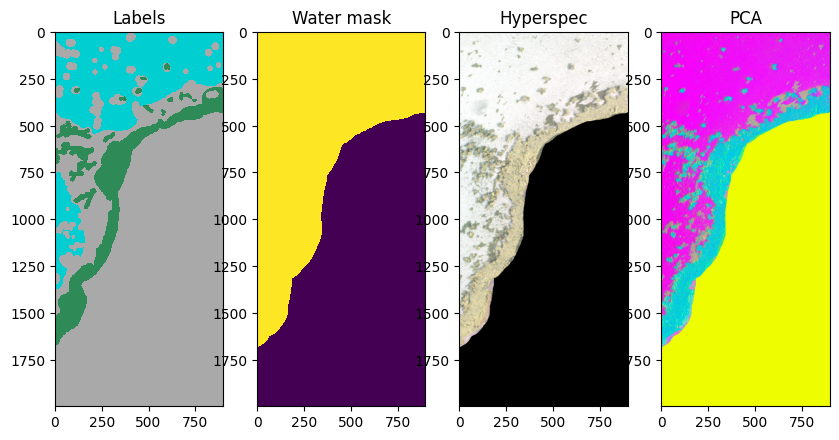

Processing image 48 of 75: Vega_SolaNW_Sound1_Pika_L_10-Crop Wavelengths.bip.png


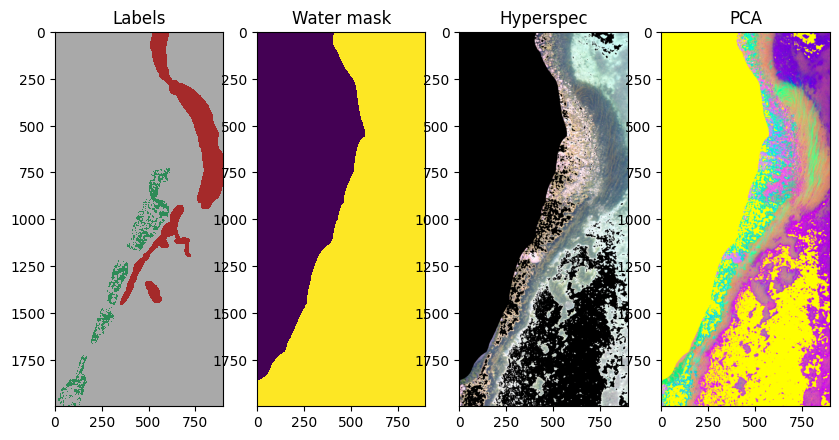

Processing image 49 of 75: Vega_SolaNW_Sound1_Pika_L_11-Crop Wavelengths.bip.png


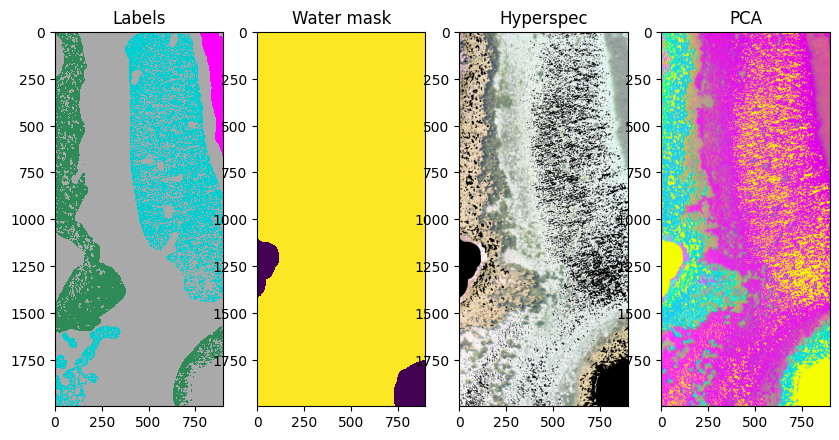

Processing image 50 of 75: Vega_SolaNW_Sound1_Pika_L_12-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


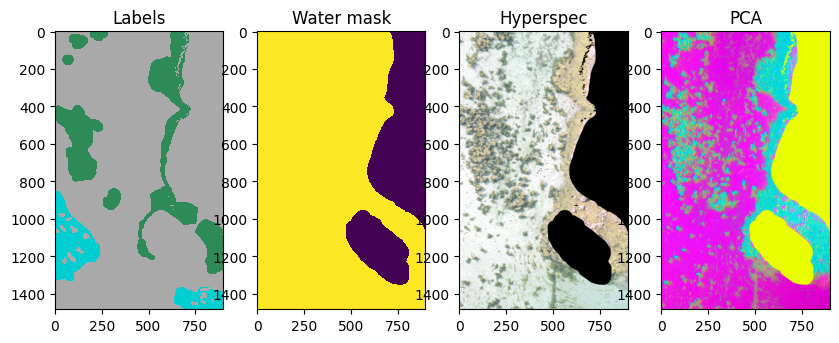

Processing image 51 of 75: Vega_SolaNW_Sound1_Pika_L_13-Crop Wavelengths.bip.png


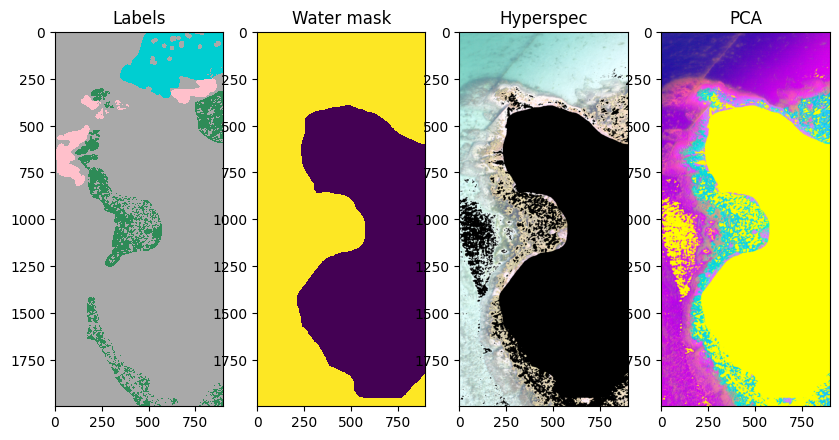

Processing image 52 of 75: Vega_SolaNW_Sound1_Pika_L_14-Crop Wavelengths.bip.png


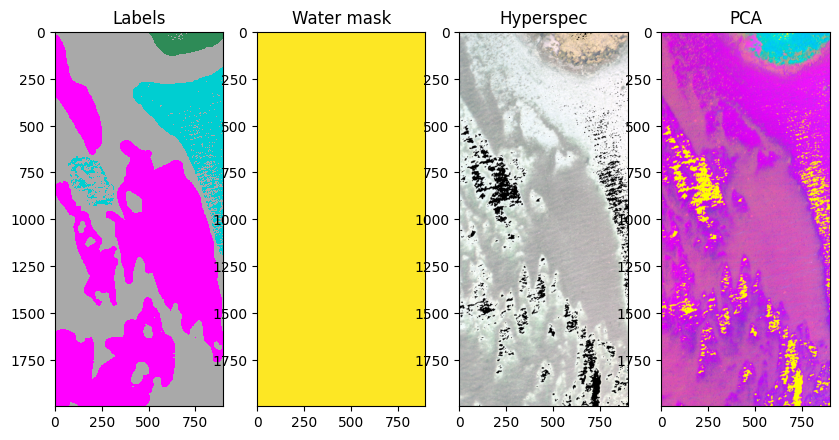

Processing image 53 of 75: Vega_SolaNW_Sound1_Pika_L_15-Crop Wavelengths.bip.png


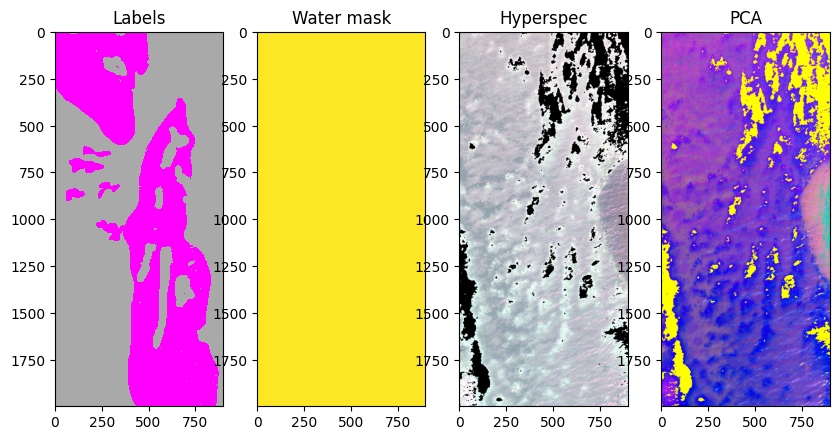

Processing image 54 of 75: Vega_SolaNW_Sound1_Pika_L_16-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


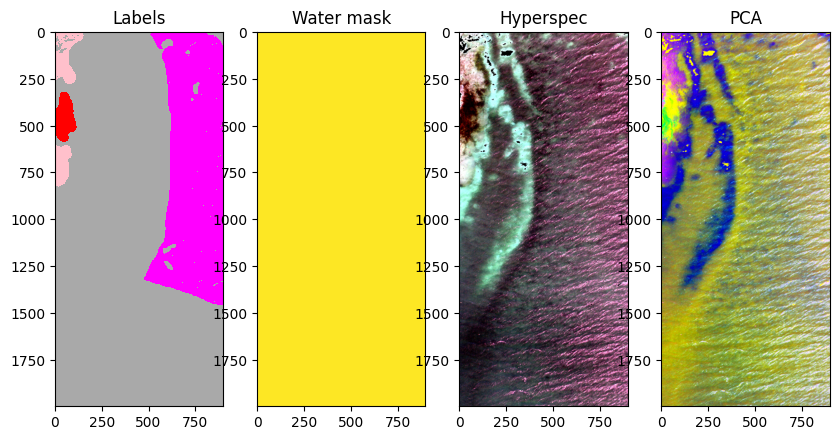

Processing image 55 of 75: Vega_SolaNW_Sound1_Pika_L_17-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


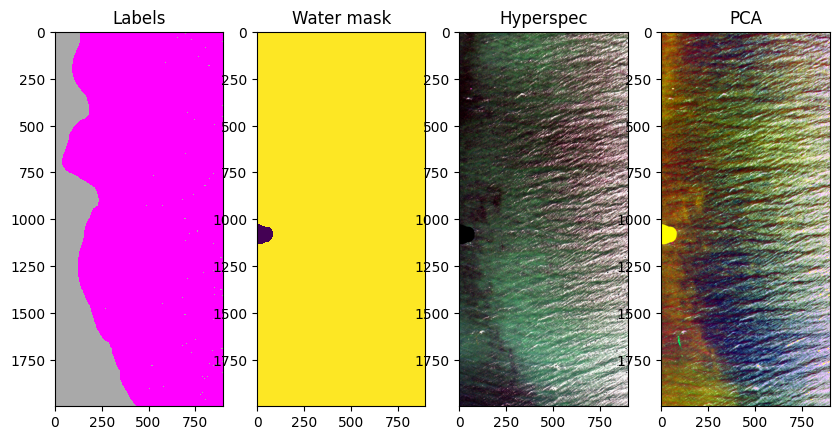

Processing image 56 of 75: Vega_SolaNW_Sound1_Pika_L_18-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


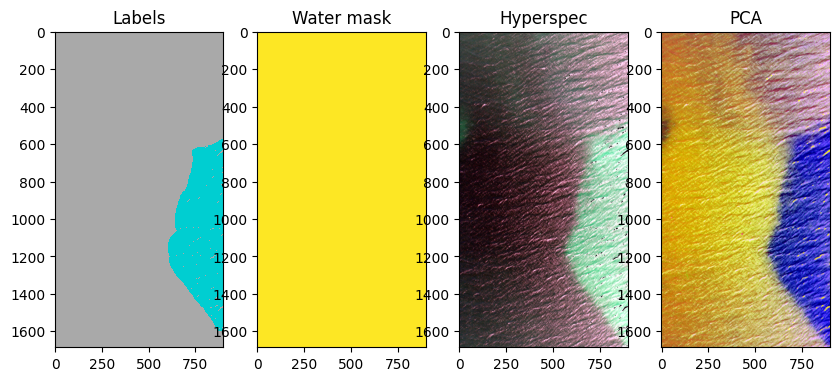

Processing image 57 of 75: Vega_SolaNW_Sound1_Pika_L_20-Crop Wavelengths.bip.png


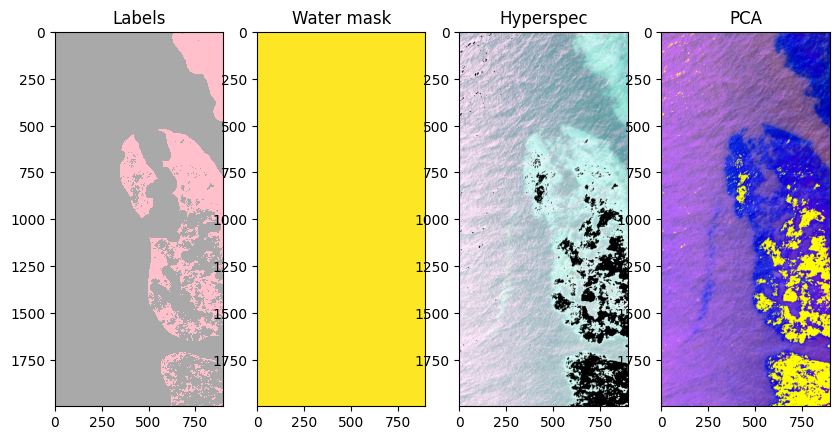

Processing image 58 of 75: Vega_SolaNW_Sound1_Pika_L_22-Crop Wavelengths.bip.png


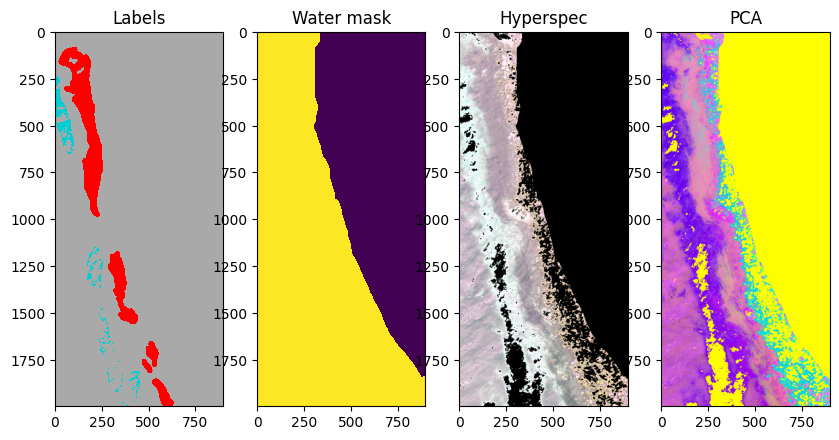

Processing image 59 of 75: Vega_SolaNW_Sound1_Pika_L_23-Crop Wavelengths.bip.png


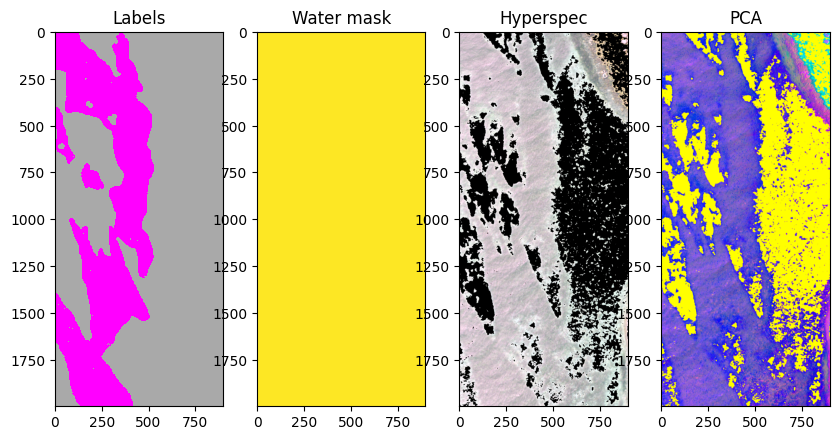

Processing image 60 of 75: Vega_SolaNW_Sound1_Pika_L_24-Crop Wavelengths.bip.png


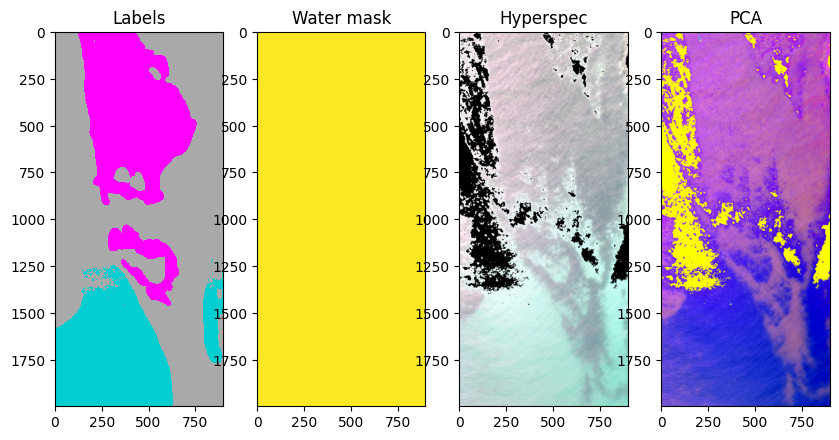

Processing image 61 of 75: Vega_SolaNW_Sound1_Pika_L_26-Crop Wavelengths.bip.png


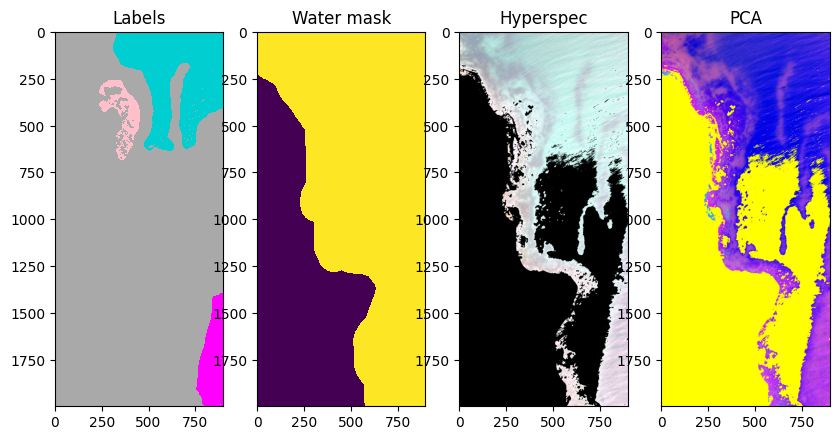

Processing image 62 of 75: Vega_SolaNW_Sound1_Pika_L_5-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


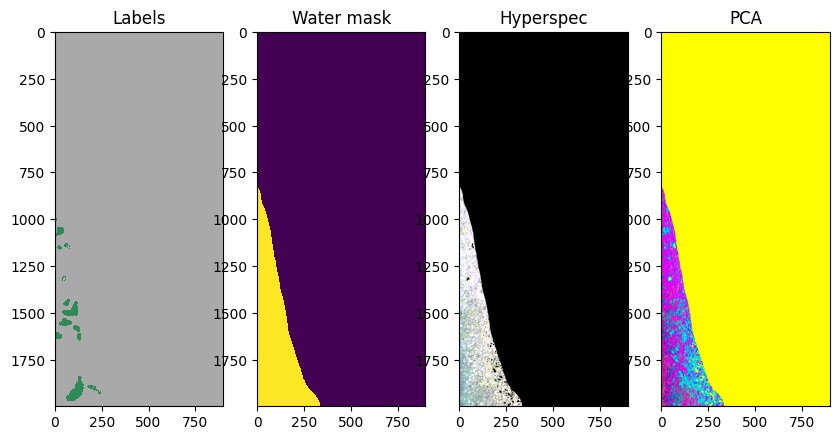

Processing image 63 of 75: Vega_SolaNW_Sound1_Pika_L_6-Crop Wavelengths.bip.png


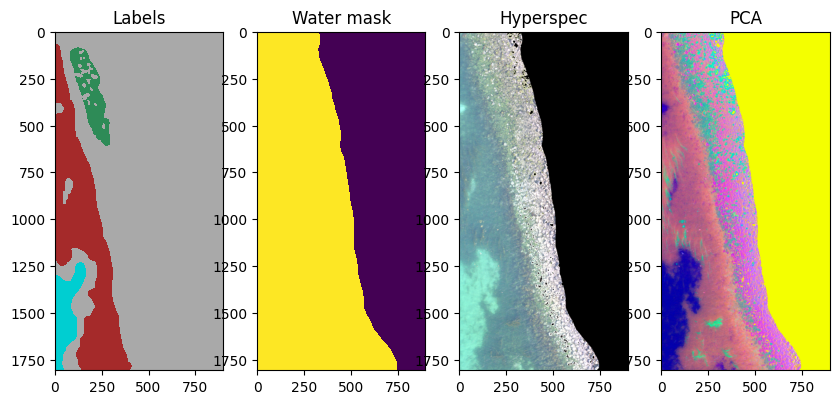

Processing image 64 of 75: Vega_SolaNW_Sound1_Pika_L_7-Crop Wavelengths.bip.png


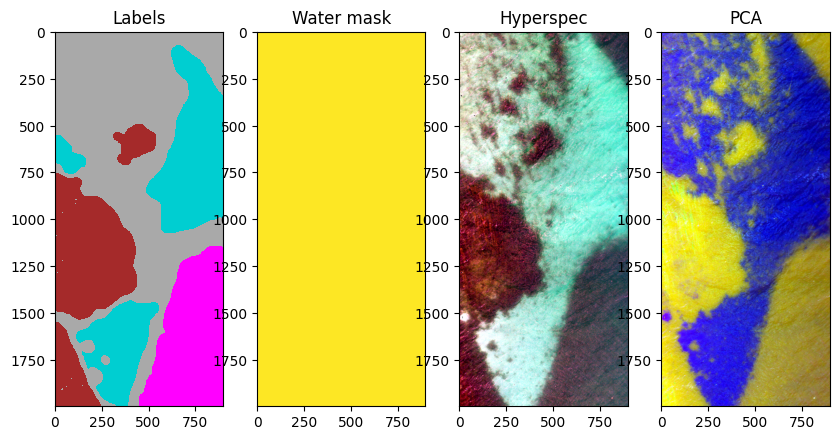

Processing image 65 of 75: Vega_SolaNW_Sound1_Pika_L_8-Crop Wavelengths.bip.png


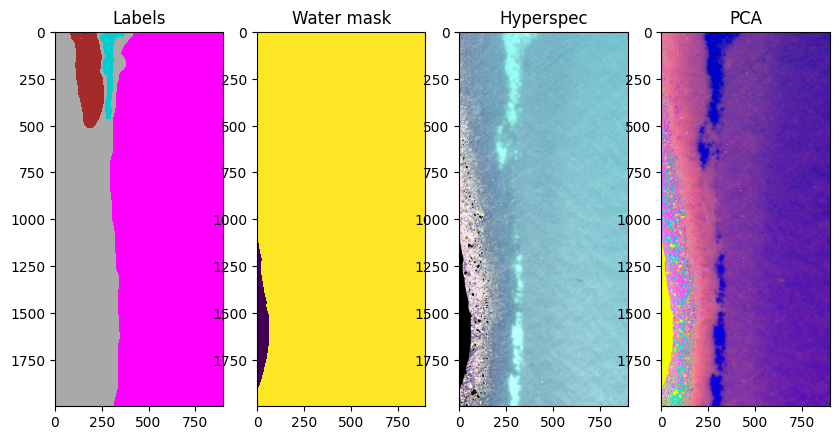

Processing image 66 of 75: Vega_SolaNW_Sound1_Pika_L_9-Crop Wavelengths.bip.png


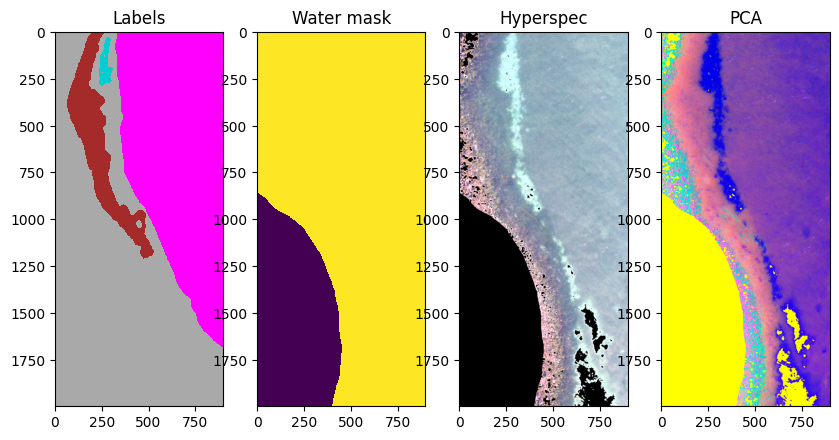

Processing image 67 of 75: Vega_SolaNW_Sound3a_Pika_L_15-Crop Wavelengths.bip.png


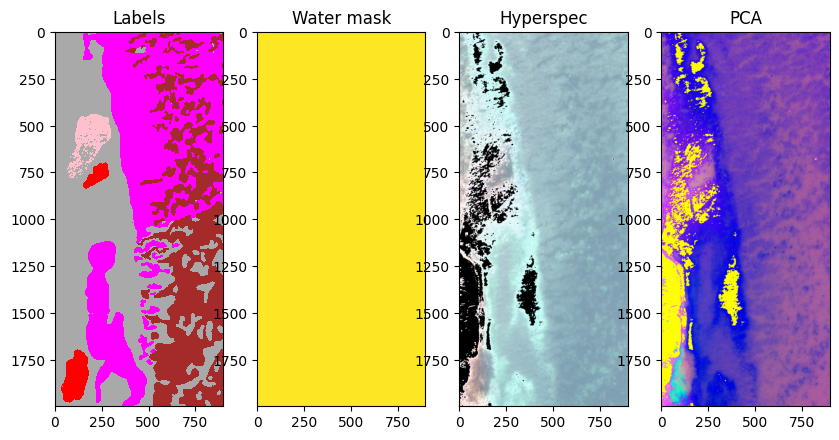

Processing image 68 of 75: Vega_SolaNW_Sound3a_Pika_L_17-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


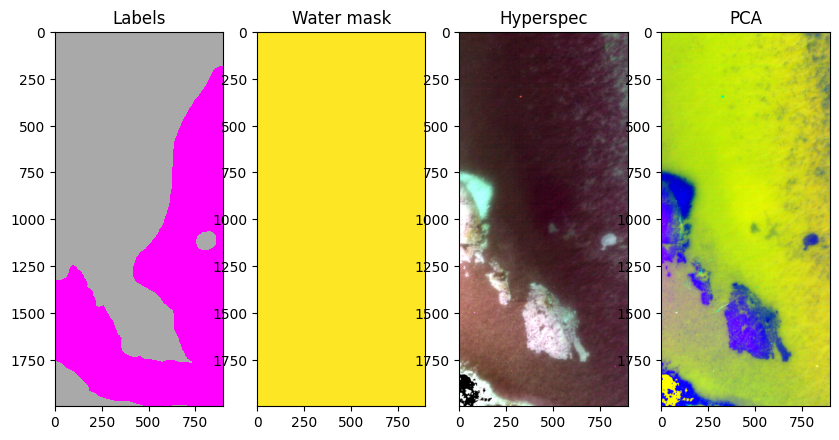

Processing image 69 of 75: Vega_SolaNW_Sound3a_Pika_L_19-Crop Wavelengths.bip.png


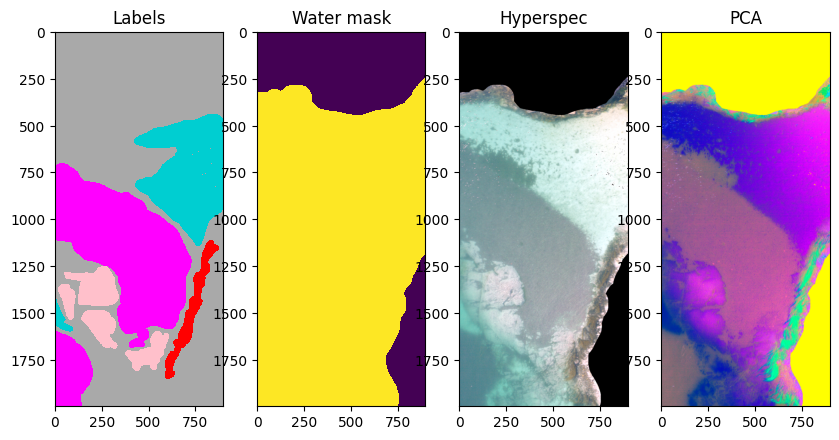

Processing image 70 of 75: Vega_SolaNW_Sound3a_Pika_L_2-Crop Wavelengths.bip.png


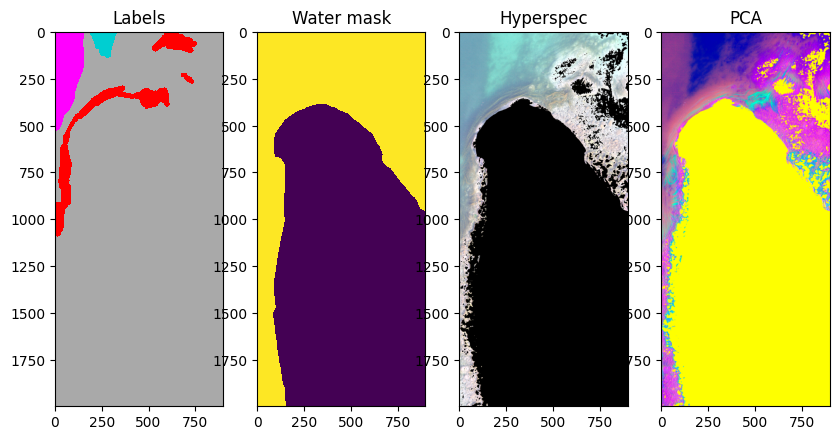

Processing image 71 of 75: Vega_SolaNW_Sound3a_Pika_L_3-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


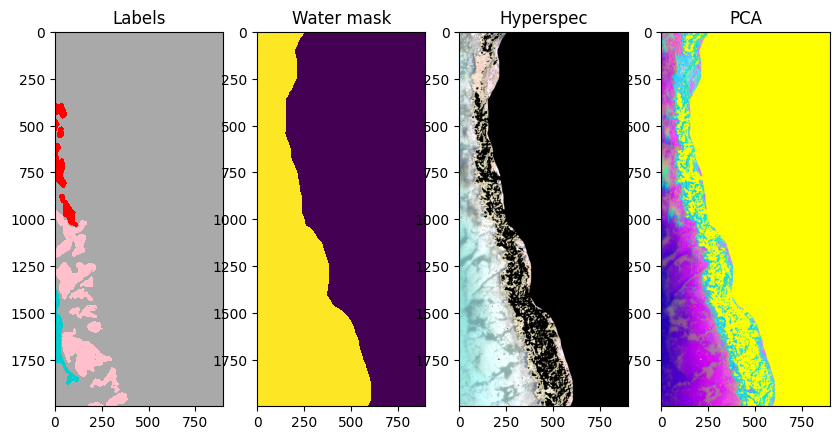

Processing image 72 of 75: Vega_SolaNW_Sound3a_Pika_L_30-Crop Wavelengths.bip.png


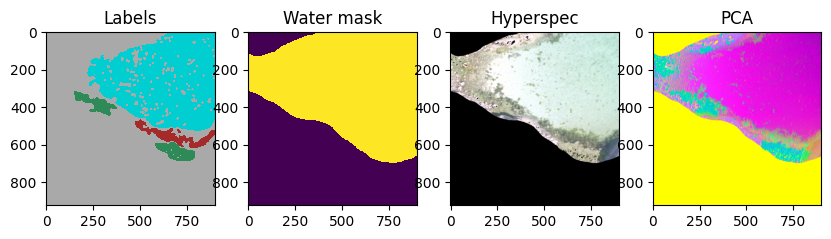

Processing image 73 of 75: Vega_SolaNW_Sound3a_Pika_L_4-Crop Wavelengths.bip.png


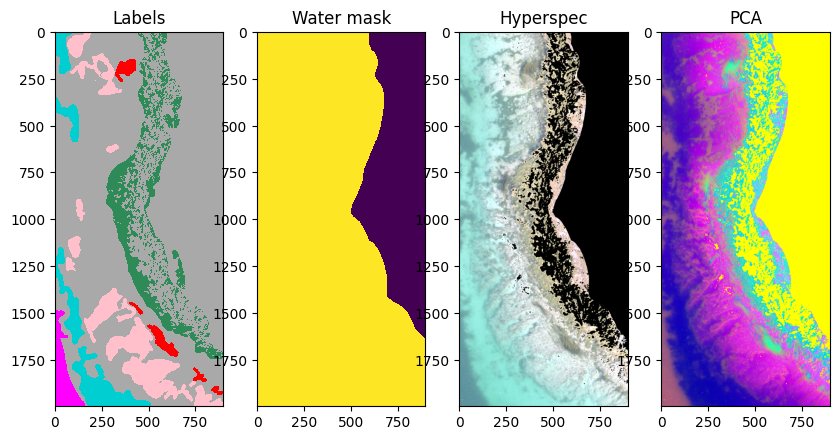

Processing image 74 of 75: Vega_SolaNW_Sound3a_Pika_L_5-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


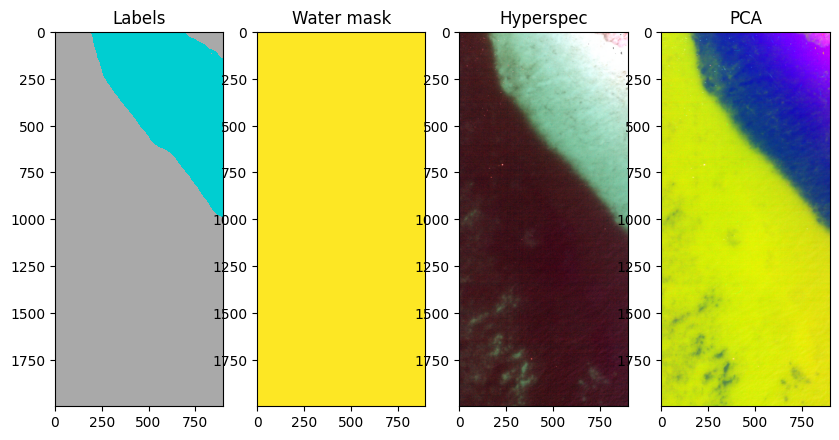

Processing image 75 of 75: Vega_SolaNW_Sound3a_Pika_L_9-Crop Wavelengths.bip.png


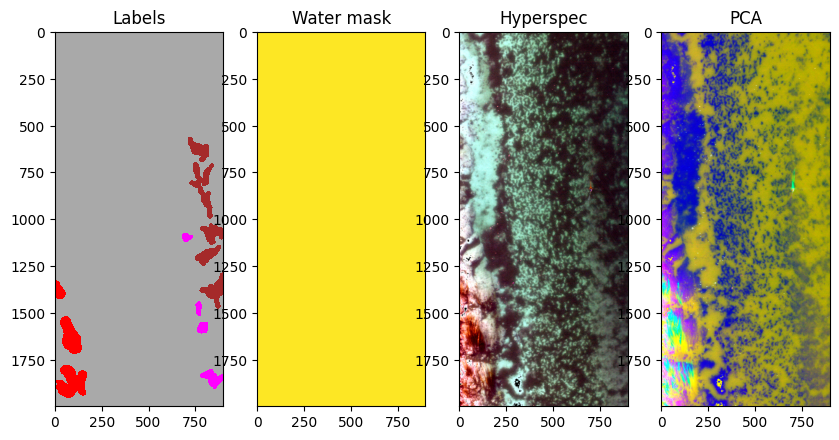

In [12]:
create_pca_images(train_label_image_paths,train_pca_im_dir,grouped_class_indices)

Processing image 1 of 39: Vega_SolaNW_Coast2_Pika_L_13-Crop Wavelengths.bip.png


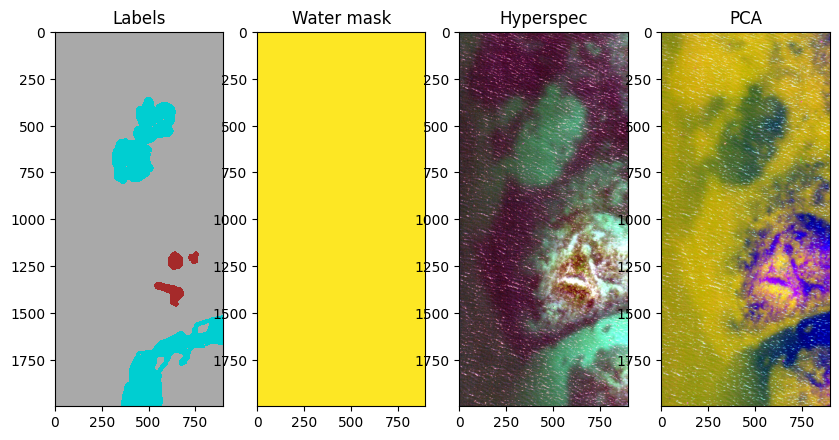

Processing image 2 of 39: Vega_SolaNW_Coast2_Pika_L_22-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


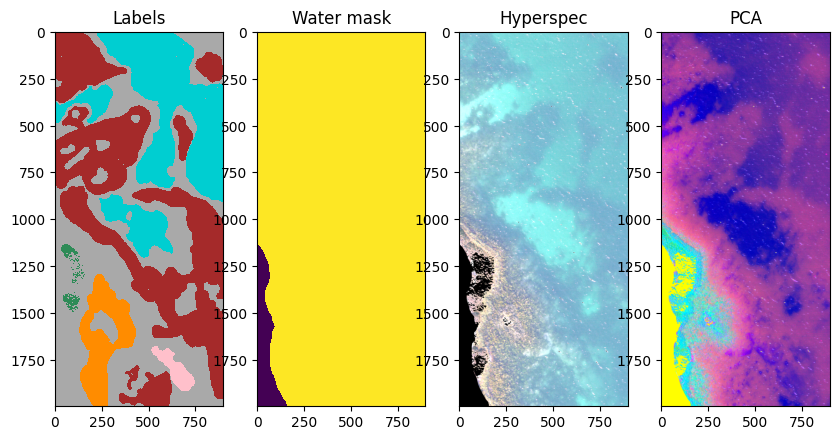

Processing image 3 of 39: Vega_SolaNW_Coast2_Pika_L_23-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


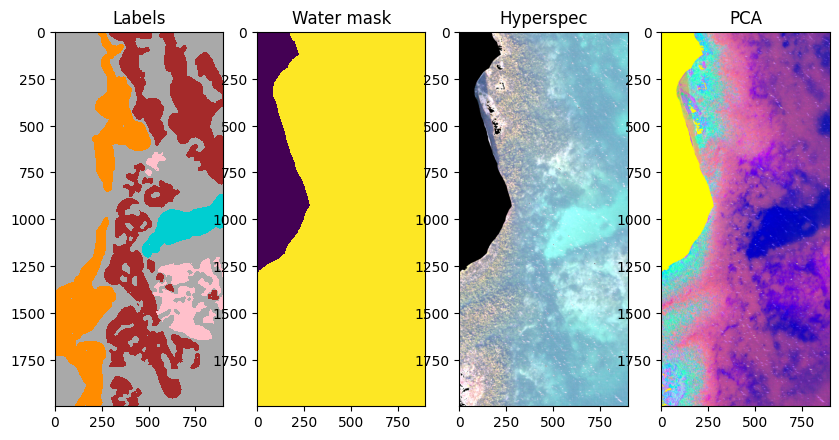

Processing image 4 of 39: Vega_SolaNW_Coast2_Pika_L_24-Crop Wavelengths.bip.png


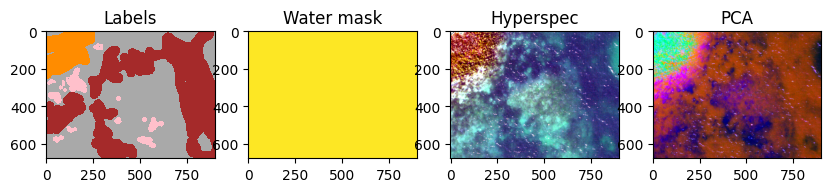

Processing image 5 of 39: Vega_SolaNW_Sound2_Pika_L_1-Crop Wavelengths.bip.png


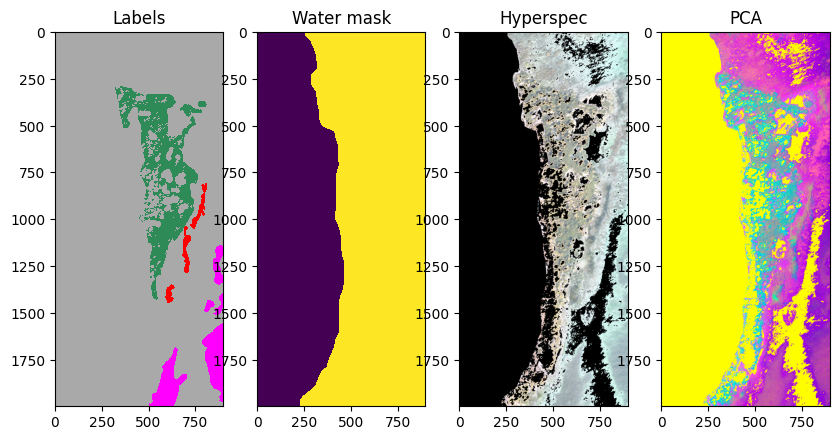

Processing image 6 of 39: Vega_SolaNW_Sound2_Pika_L_10-Crop Wavelengths.bip.png


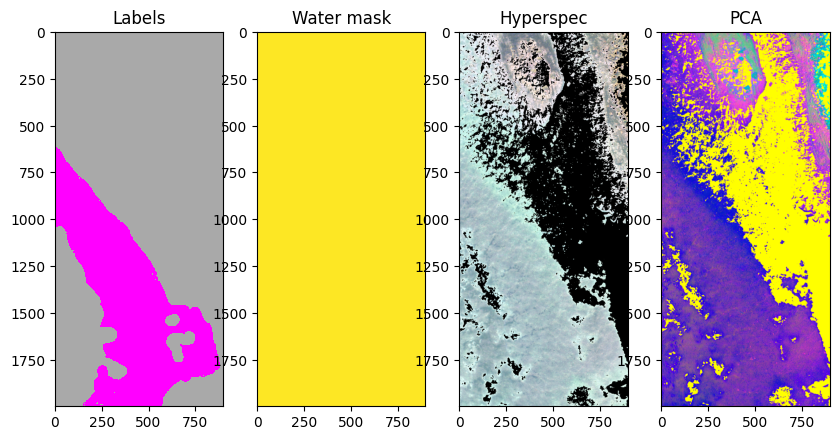

Processing image 7 of 39: Vega_SolaNW_Sound2_Pika_L_11-Crop Wavelengths.bip.png


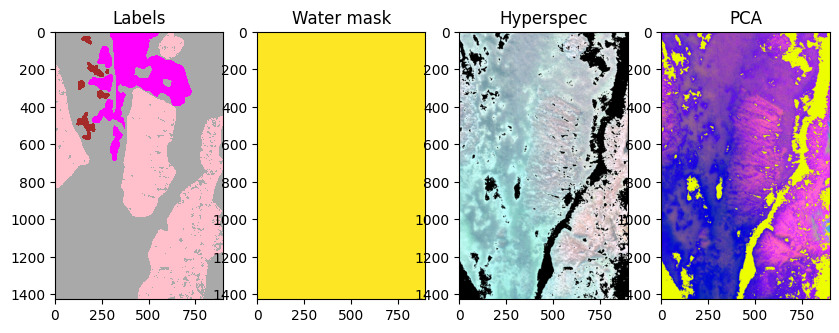

Processing image 8 of 39: Vega_SolaNW_Sound2_Pika_L_12-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


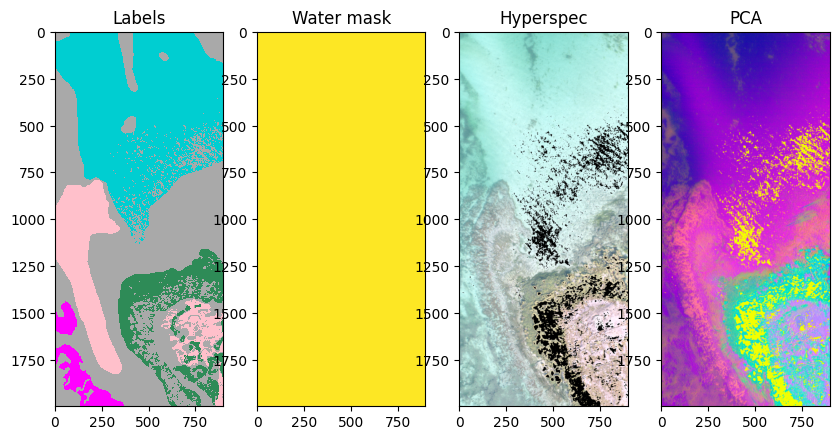

Processing image 9 of 39: Vega_SolaNW_Sound2_Pika_L_13-Crop Wavelengths.bip.png


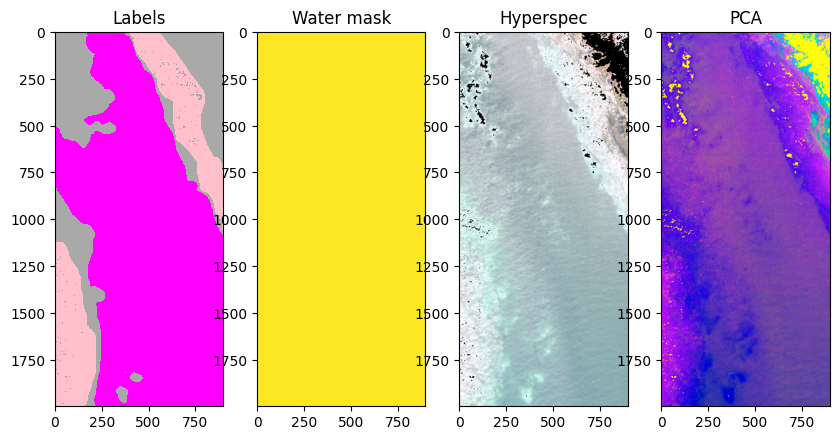

Processing image 10 of 39: Vega_SolaNW_Sound2_Pika_L_14-Crop Wavelengths.bip.png


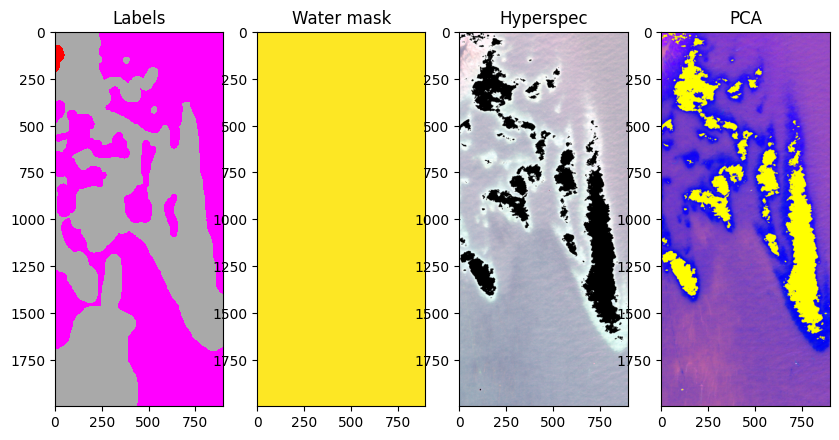

Processing image 11 of 39: Vega_SolaNW_Sound2_Pika_L_2-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


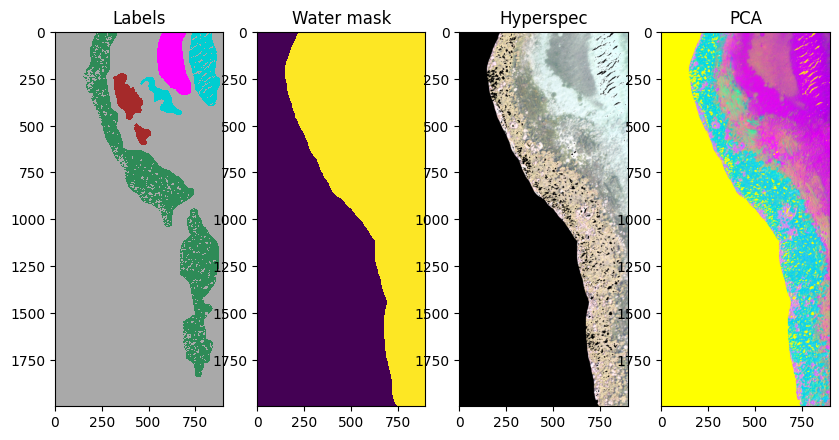

Processing image 12 of 39: Vega_SolaNW_Sound2_Pika_L_21-Crop Wavelengths.bip.png


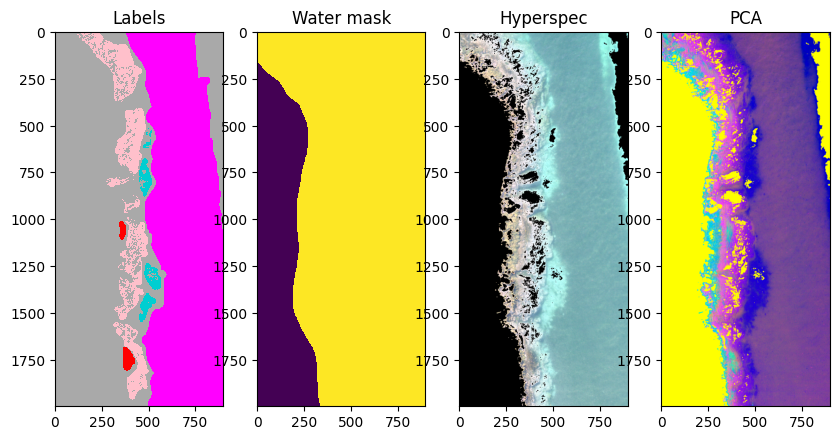

Processing image 13 of 39: Vega_SolaNW_Sound2_Pika_L_22-Crop Wavelengths.bip.png


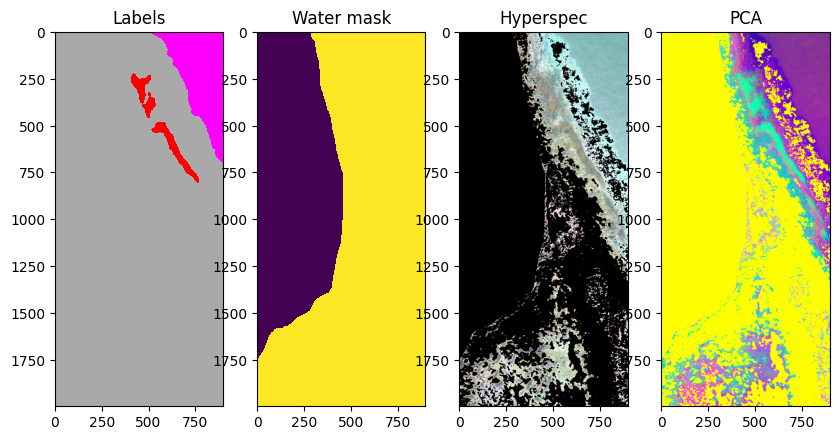

Processing image 14 of 39: Vega_SolaNW_Sound2_Pika_L_23-Crop Wavelengths.bip.png


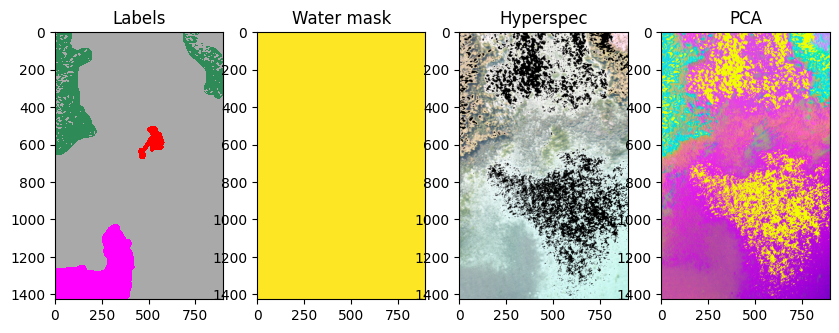

Processing image 15 of 39: Vega_SolaNW_Sound2_Pika_L_24-Crop Wavelengths.bip.png


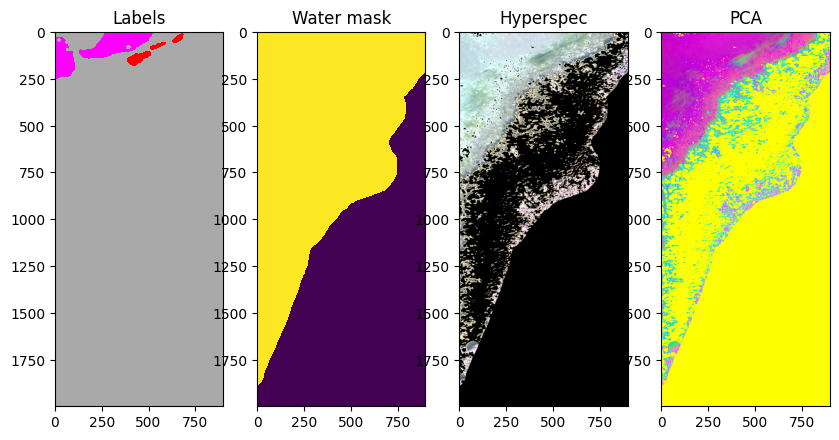

Processing image 16 of 39: Vega_SolaNW_Sound2_Pika_L_26-Crop Wavelengths.bip.png


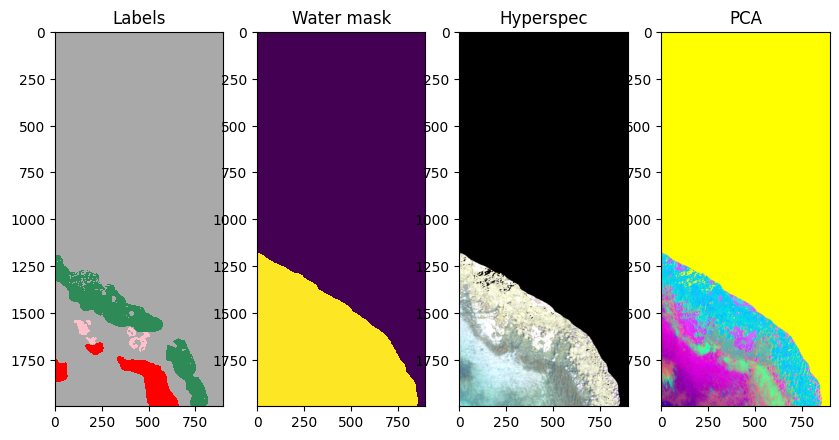

Processing image 17 of 39: Vega_SolaNW_Sound2_Pika_L_27-Crop Wavelengths.bip.png


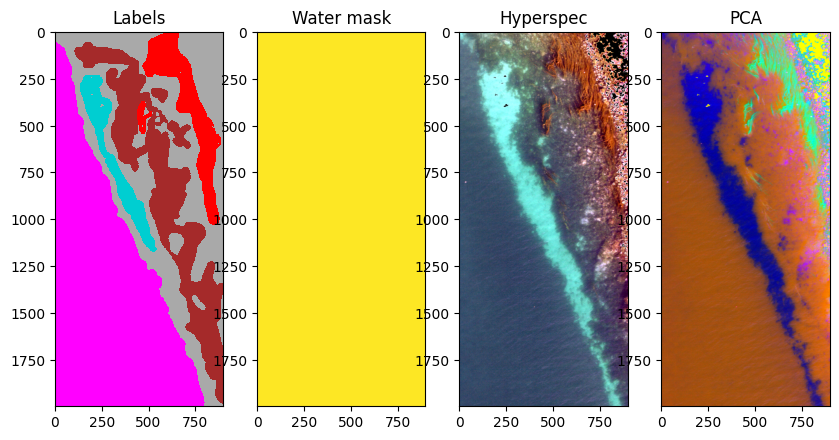

Processing image 18 of 39: Vega_SolaNW_Sound2_Pika_L_31-Crop Wavelengths.bip.png


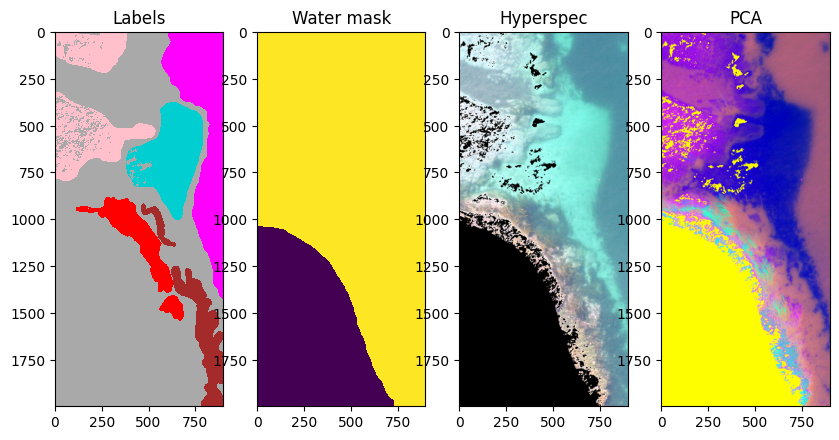

Processing image 19 of 39: Vega_SolaNW_Sound2_Pika_L_32-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


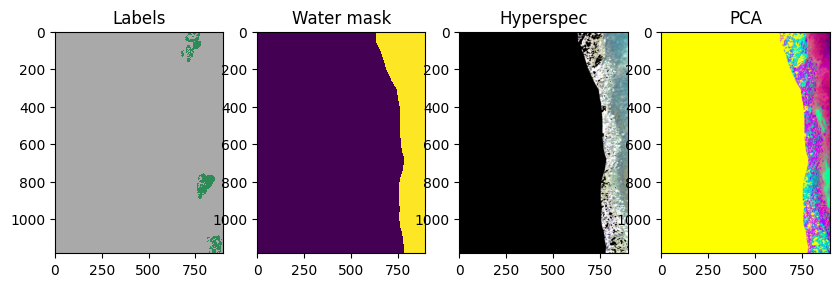

Processing image 20 of 39: Vega_SolaNW_Sound2_Pika_L_4-Crop Wavelengths.bip.png


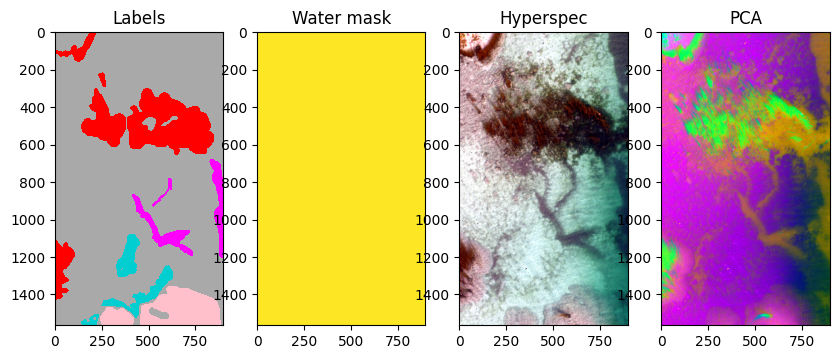

Processing image 21 of 39: Vega_SolaNW_Sound2_Pika_L_6-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


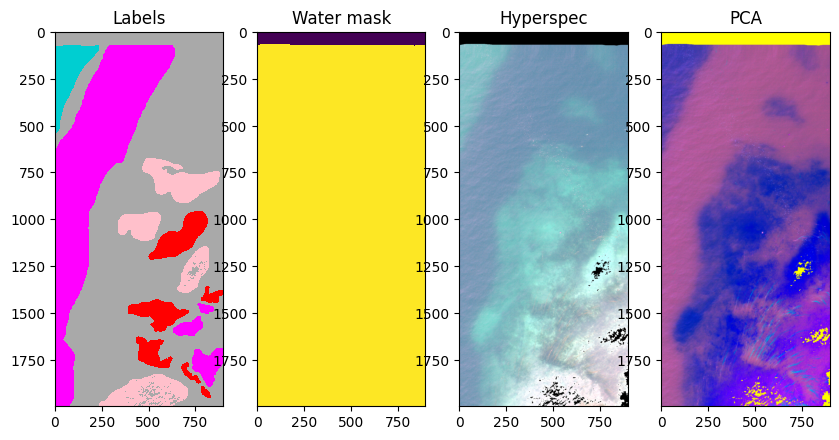

Processing image 22 of 39: Vega_SolaNW_Sound2_Pika_L_7-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


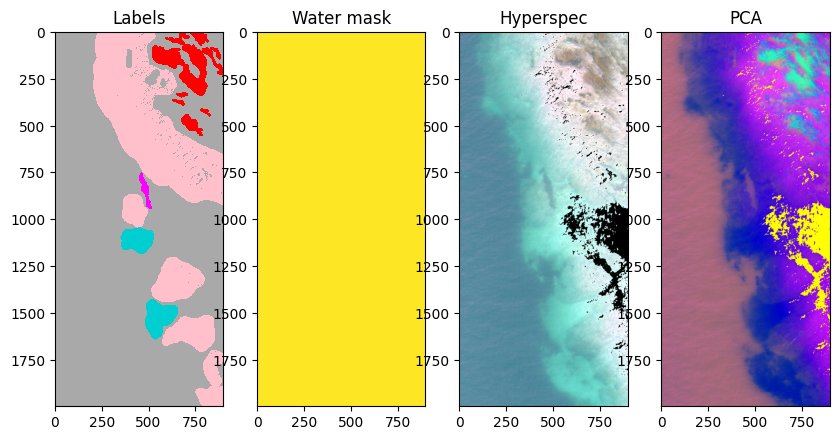

Processing image 23 of 39: Vega_SolaNW_Sound2_Pika_L_8-Crop Wavelengths.bip.png


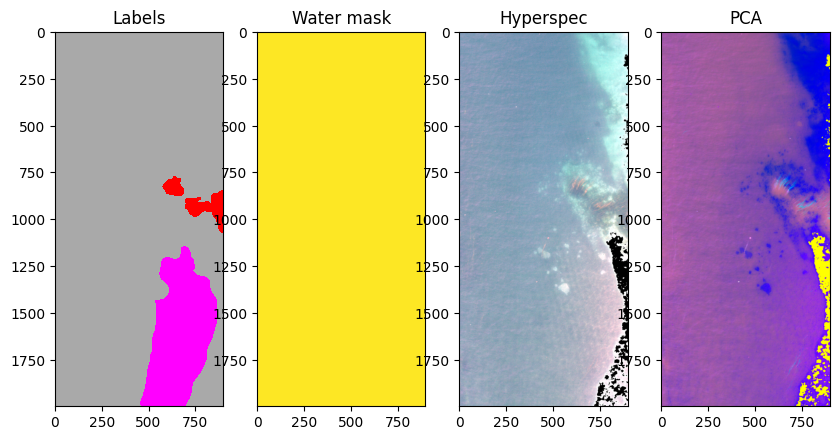

Processing image 24 of 39: Vega_SolaNW_Sound2_Pika_L_9-Crop Wavelengths.bip.png


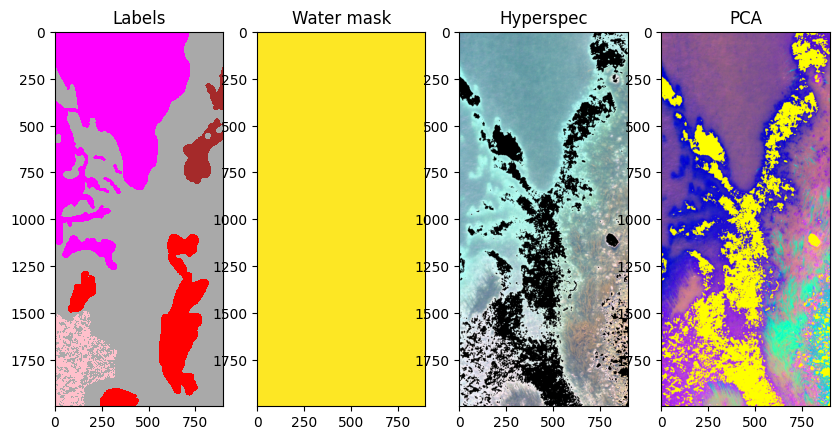

Processing image 25 of 39: Vega_SolaNW_Sound3b_Pika_L_1-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


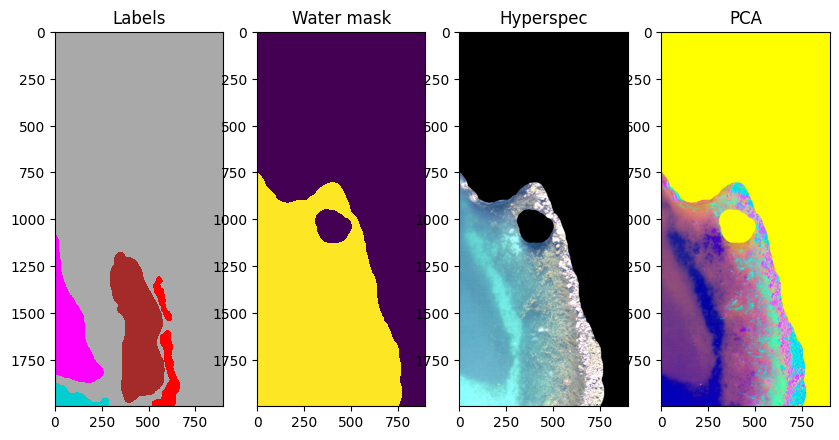

Processing image 26 of 39: Vega_SolaNW_Sound3b_Pika_L_13-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


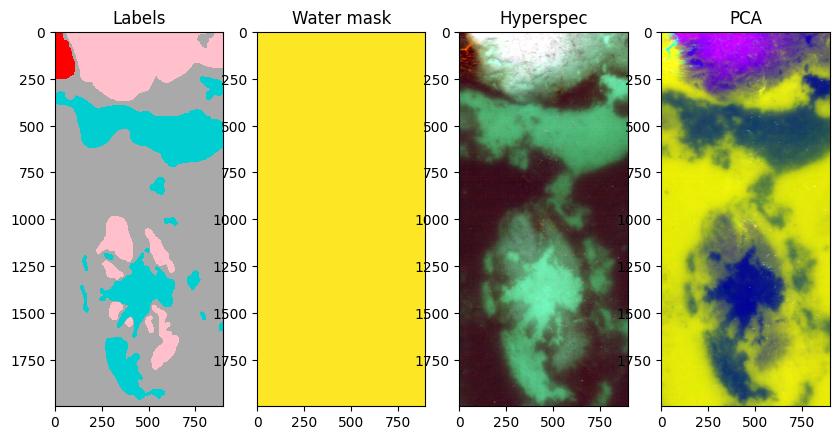

Processing image 27 of 39: Vega_SolaNW_Sound3b_Pika_L_15-Crop Wavelengths.bip.png


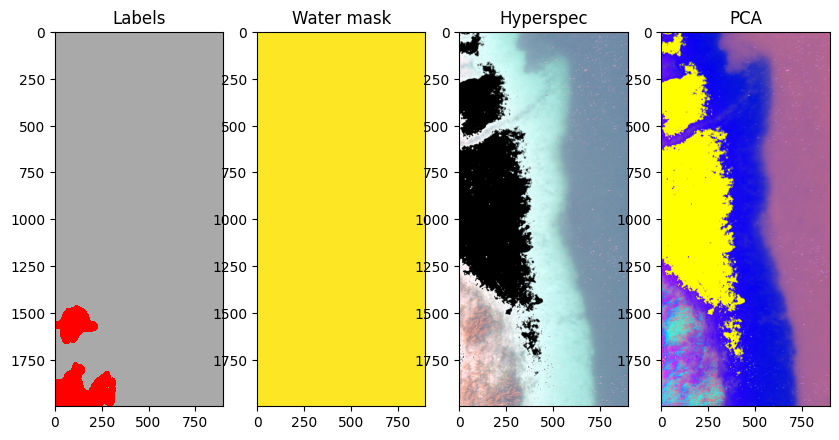

Processing image 28 of 39: Vega_SolaNW_Sound3b_Pika_L_17-Crop Wavelengths.bip.png


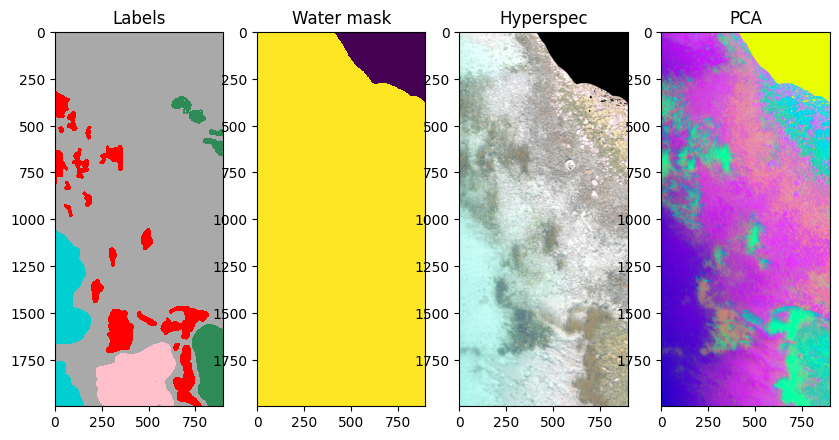

Processing image 29 of 39: Vega_SolaNW_Sound3b_Pika_L_18-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


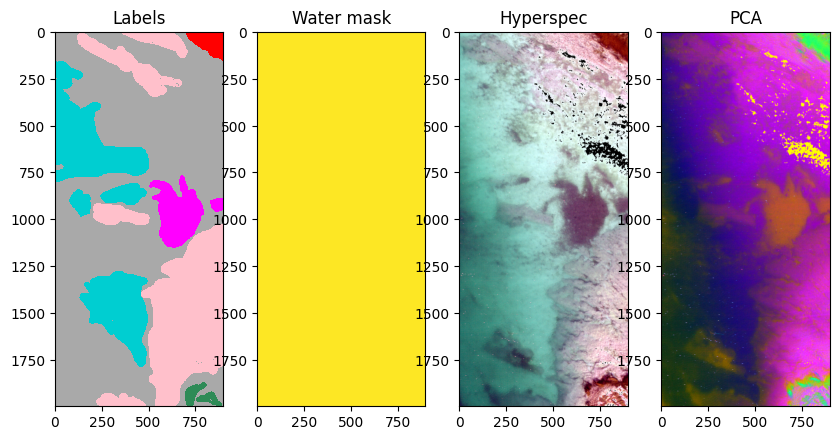

Processing image 30 of 39: Vega_SolaNW_Sound3b_Pika_L_19-Crop Wavelengths.bip.png


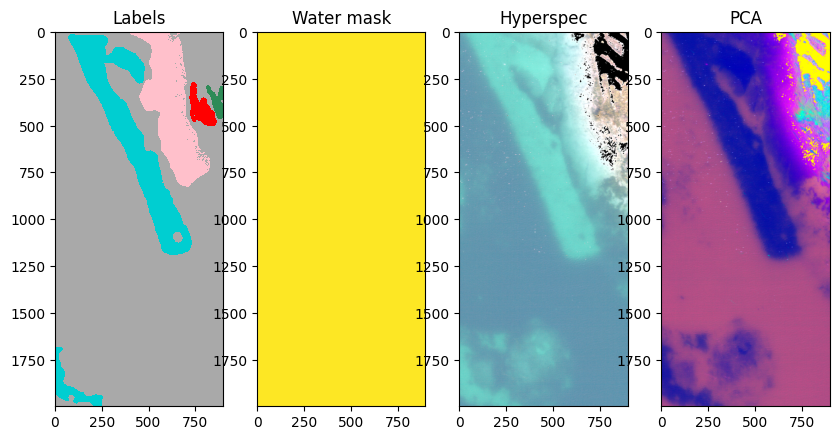

Processing image 31 of 39: Vega_SolaNW_Sound3b_Pika_L_2-Crop Wavelengths.bip.png


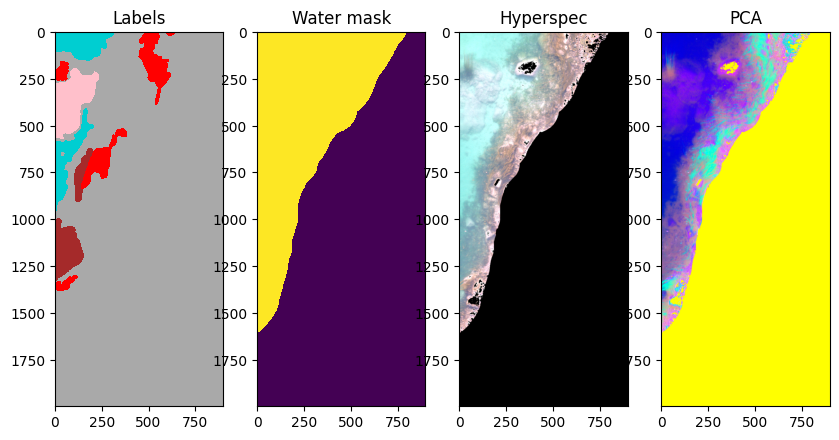

Processing image 32 of 39: Vega_SolaNW_Sound3b_Pika_L_20-Crop Wavelengths.bip.png


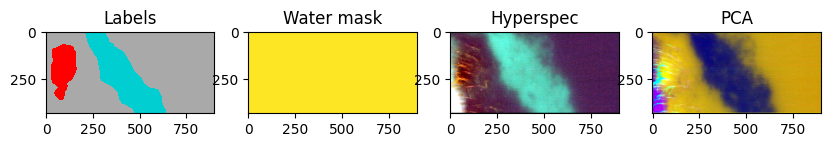

Processing image 33 of 39: Vega_SolaNW_Sound3b_Pika_L_22-Crop Wavelengths.bip.png


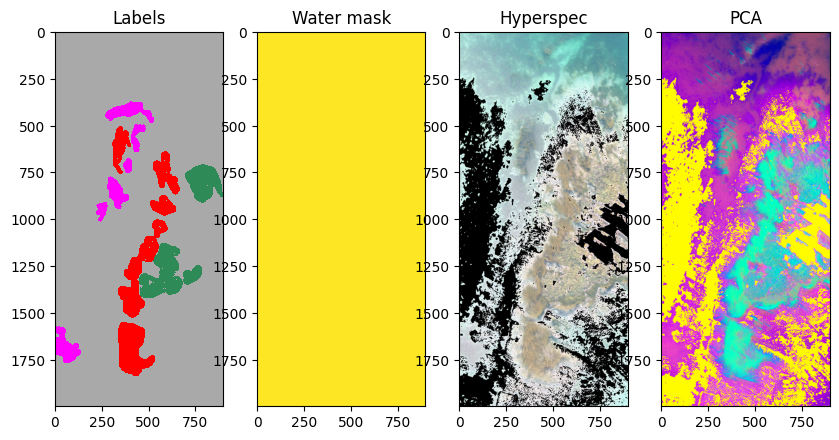

Processing image 34 of 39: Vega_SolaNW_Sound3b_Pika_L_23-Crop Wavelengths.bip.png


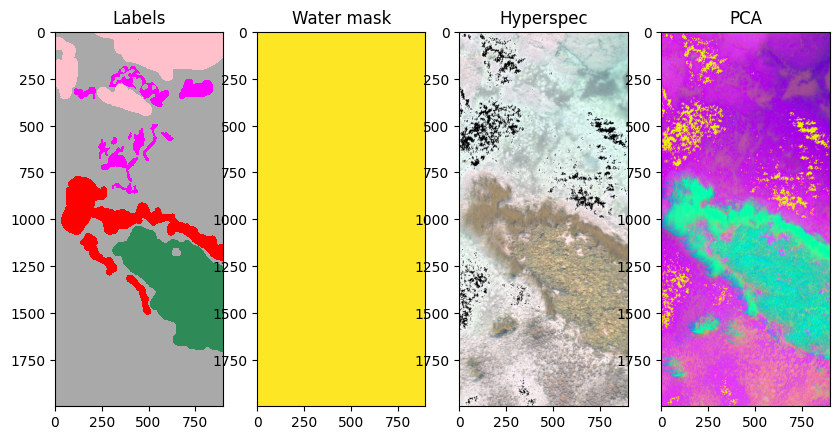

Processing image 35 of 39: Vega_SolaNW_Sound3b_Pika_L_24-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


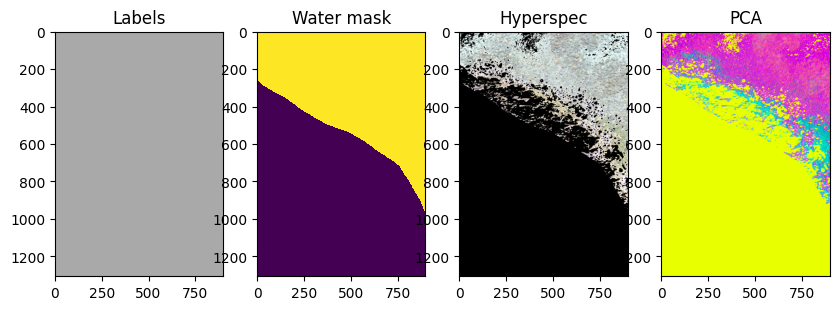

Processing image 36 of 39: Vega_SolaNW_Sound3b_Pika_L_25-Crop Wavelengths.bip.png


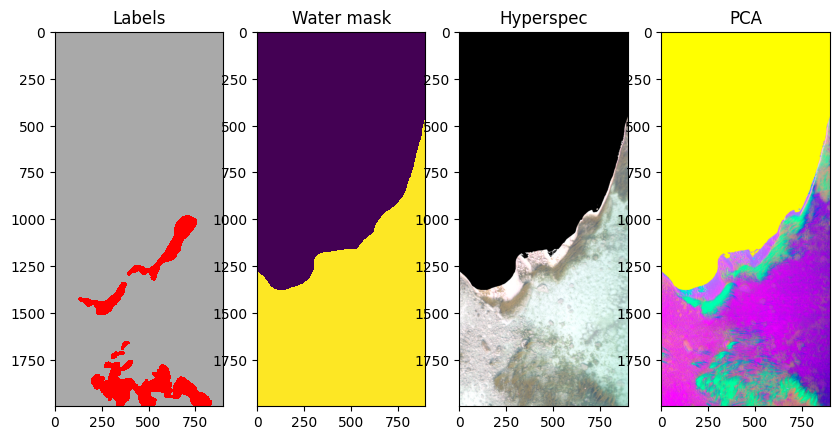

Processing image 37 of 39: Vega_SolaNW_Sound3b_Pika_L_26-Crop Wavelengths.bip.png


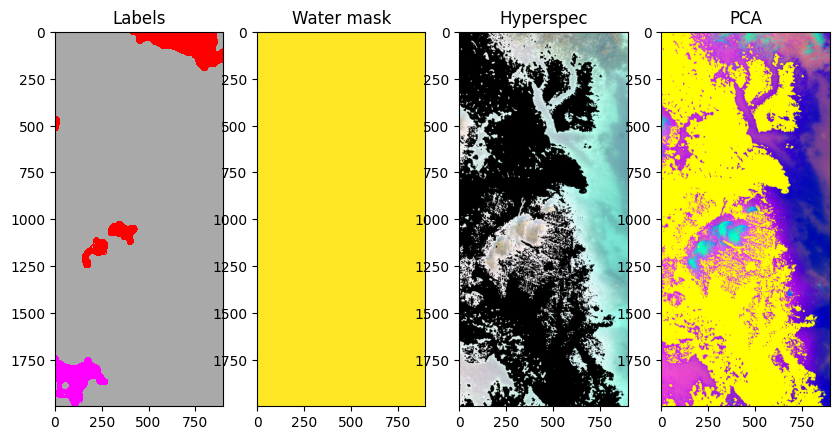

Processing image 38 of 39: Vega_SolaNW_Sound3b_Pika_L_27-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


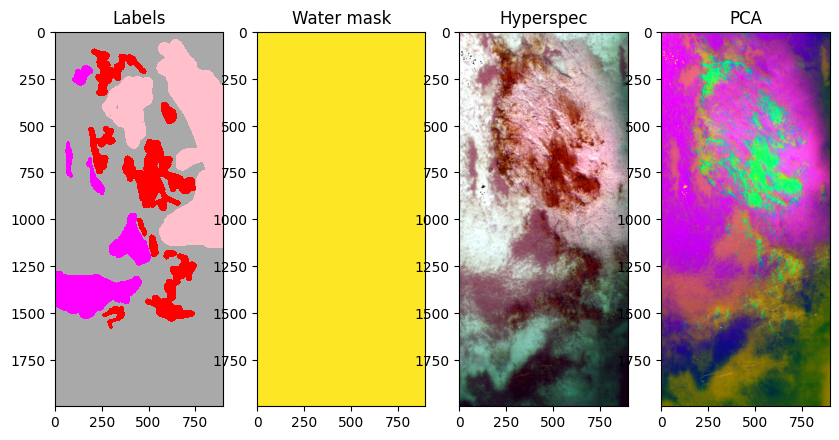

Processing image 39 of 39: Vega_SolaNW_Sound3b_Pika_L_5-Crop Wavelengths.bip.png


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


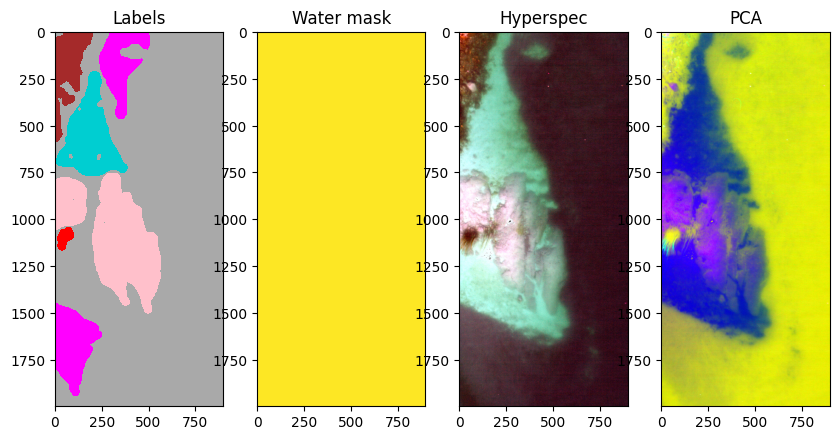

In [13]:
create_pca_images(val_label_image_paths,val_pca_im_dir,grouped_class_indices)